«Анализ электропотребления физических лиц и их платежной дисциплины (поиск инсайтов, составление рекомендаций стейкхолдерам, построение предиктивной модели)»

In [1]:
import pandas as pd
import pickle
import numpy as np
from datetime import datetime
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
import math

In [ ]:
1. Загрузка информации для датасета - Электропотребления за 2018-2022 годы

In [109]:
# Загрузка информации об объемах электропотребления за 2018-2022 годы
df_vol18 = pd.read_excel('vol1218.xlsx')
df_vol19 = pd.read_excel('vol1219.xlsx')
df_vol20 = pd.read_excel('vol1220.xlsx')
df_vol21 = pd.read_excel('vol1221.xlsx')
df_vol22 = pd.read_excel('vol1222.xlsx')
# Объединение в один датафрейм
df_vol_0=pd.concat([df_vol18,df_vol19, df_vol20, df_vol21, df_vol22])
df_vol_0.info()

C:\Users\Андрей Ковалев\AppData\Local\Temp\ipykernel_4676\2422188093.py:2: FutureWarning: Inferring datetime64[ns] from data containing strings is deprecated and will be removed in a future version. To retain the old behavior explicitly pass Series(data, dtype=datetime64[ns])
  df_vol18 = pd.read_excel('vol1218.xlsx')
C:\Users\Андрей Ковалев\AppData\Local\Temp\ipykernel_4676\2422188093.py:3: FutureWarning: Inferring datetime64[ns] from data containing strings is deprecated and will be removed in a future version. To retain the old behavior explicitly pass Series(data, dtype=datetime64[ns])
  df_vol19 = pd.read_excel('vol1219.xlsx')
C:\Users\Андрей Ковалев\AppData\Local\Temp\ipykernel_4676\2422188093.py:4: FutureWarning: Inferring datetime64[ns] from data containing strings is deprecated and will be removed in a future version. To retain the old behavior explicitly pass Series(data, dtype=datetime64[ns])
  df_vol20 = pd.read_excel('vol1220.xlsx')
C:\Users\Андрей Ковалев\AppData\Local\Te

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5242875 entries, 0 to 1048574
Data columns (total 38 columns):
 #   Column      Dtype         
---  ------      -----         
 0   LSCHET      int64         
 1   FAM         float64       
 2   IMYA        float64       
 3   OTCH        float64       
 4   PUNKT       object        
 5   RAYON       object        
 6   UL          object        
 7   DOM         object        
 8   KVART       object        
 9   KOMN        float64       
 10  TIPSH       object        
 11  NOMSH       object        
 12  KTR         int64         
 13  DATA_PRED   datetime64[ns]
 14  POK_PRED    int64         
 15  TYP_POK_PR  object        
 16  DATA_POSL   datetime64[ns]
 17  POK_POSL    int64         
 18  TYP_POK     object        
 19  OB_POTR     float64       
 20  OB_SHET     float64       
 21  OB_SR       int64         
 22  OB_NORM     float64       
 23  OB_BEZUCH   float64       
 24  OB_PERERAS  float64       
 25  ODN         float6

Очистка данных

In [110]:
# Список столбцов к удалению, использование которых не планируется в рамках текущей работы.
list_columns_drop = ['FAM',
 'IMYA',
 'OTCH',
 'UL',
 'DOM',
 'KVART',
 'KOMN',
 'DATA_PRED',
 'POK_PRED',
 'TYP_POK_PR',
 'DATA_POSL',
 'POK_POSL',
 'TYP_POK',
 'OB_SHET',
 'OB_SR',
 'OB_PERERAS',
 'V_SOCIAL',
 'V_OVER',
 'KODUSL',
 'OLD_LS',
 'SETY',
 'LS_MRSK',
 'OGRANICH',
 'DTOGRANICH',
 'DOGUK']
# Удаление не нужных слобцов
df_vol_1 = df_vol_0.drop(columns = list_columns_drop)
df_vol_1.head()

,LSCHET,PUNKT,RAYON,TIPSH,NOMSH,KTR,OB_POTR,OB_NORM,OB_BEZUCH,ODN,STATUS_SCH,SOSTOYANIE,TIPSTROY
0,230407060236,г Хадыженск,Апшеронский участок,СО-505,236141,1,20.0,0.0,0.0,0.0,Работает,Постоянный,Частный
1,230407060690,г Хадыженск,Апшеронский участок,СО-505,239294,1,100.0,0.0,0.0,0.0,Работает,Постоянный,Частный
2,230407060832,г Хадыженск,Апшеронский участок,СО-2,083430,1,20.0,0.0,0.0,0.0,Работает,Постоянный,Частный
3,230407061381,г Хадыженск,Апшеронский участок,СО-505,001541,1,0.0,0.0,0.0,0.0,Работает,Постоянный,Частный
4,230407061719,г Хадыженск,Апшеронский участок,СО-И446М,0020282,1,120.0,0.0,0.0,0.0,Работает,Постоянный,Частный


In [111]:
# Общая информация, датафрейм состоит из более 5 миллионов строк
df_vol_1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5242875 entries, 0 to 1048574
Data columns (total 13 columns):
 #   Column      Dtype  
---  ------      -----  
 0   LSCHET      int64  
 1   PUNKT       object 
 2   RAYON       object 
 3   TIPSH       object 
 4   NOMSH       object 
 5   KTR         int64  
 6   OB_POTR     float64
 7   OB_NORM     float64
 8   OB_BEZUCH   float64
 9   ODN         float64
 10  STATUS_SCH  object 
 11  SOSTOYANIE  object 
 12  TIPSTROY    object 
dtypes: float64(4), int64(2), object(7)
memory usage: 560.0+ MB


Описание полей датасета - Электропотребление за период 2018-2022

Имя столбца	Описание
LSCHET	Номер лицевого счета, является идентификатором
PUNKT	Населенный пункт
RAYON	Участок (группа населенных пунктов)
TIPSH	Тип (модель) счетчика
NOMSH	Номер счетчика, является уникальным
KTR	Коэффициент трансформации (технический параметр)
OB_POTR	Объем электроэнергии, потребленный за месяц, у.е.2
OB_BEZUCH	Объем безучетной электроэнергии, у.е.2
STATUS_SCH	Статус работы счетчика с указание зоны суток
SOSTOYANIE	Состояние объекта (постоянный, не проживает, сезонный и т.д.)
TIPSTROY	Тип объекта (частный, многоквартирный, гараж, баня и т.д.)

In [112]:
df_vol_1.describe()

,LSCHET,KTR,OB_POTR,OB_NORM,OB_BEZUCH,ODN
count,5.242875e+06,5.242875e+06,5.242875e+06,5.242875e+06,5.242875e+06,5.242875e+06
mean,2.305117e+11,1.025904e+00,2.237804e+02,3.419219e+00,1.797564e-01,-3.465273e-01
std,3.429234e+08,6.025376e+00,6.744982e+02,2.645863e+01,4.553731e+01,4.029789e+01
min,2.301010e+11,0.000000e+00,-1.909840e+05,0.000000e+00,-5.261000e+04,-1.215050e+04
25%,2.303031e+11,1.000000e+00,3.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,2.304050e+11,1.000000e+00,1.250000e+02,0.000000e+00,0.000000e+00,0.000000e+00
75%,2.306052e+11,1.000000e+00,2.600000e+02,0.000000e+00,0.000000e+00,0.000000e+00
max,2.311100e+11,8.000000e+03,4.654100e+05,5.758000e+03,2.170000e+04,6.269448e+03


In [113]:
# Для удобства сохраним общий, очищенный датафрейм в виде pkl файла
df_vol_1.to_pickle (" df_vol_1.pkl ")

In [123]:
# Для открытия pkl файла
with open(' df_vol_1.pkl ', 'rb') as f:
     df_vol_1 = pickle.load(f)

2. Загрузка информации по датасету - Дебиторская задолженность по состоянию на 1 число 2019-2023 года и проведенных мероприятиях по погашению ДЗ

In [2]:
# Быстрая загрузка датафрейма ДЗ
with open('df_dz_2.pickle', 'rb') as f:
    df_dz_2 = pickle.load(f)
    
df_dz_2.head()

,№ лицевого счета,Структурное подразделение,Состояние лицевого счета,Тип прибора учета,Тип строения,"Дебиторская задолженность итоговая, руб.","Текущая ДЗ, руб.","Начало образования задолженности, период","Кратность ДЗ на конец отчетного периода, ед.","Оплачено в отчетном периоде,руб.",...,Безнадежная,Прочая задолженность,Дата рождения,Место рождения,Документ удостоверяющий личность,ДЗ по состоянию на,Филиал,Участок,Ограничение,Суд
1.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,СО-ЭЭ6706 №921382,Частный,17586.78,0.00,5.2018,4.000000,0.0,...,0.0,17586.78,1976-08-05,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа производилась
2.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,NaN,Частный,2018.65,1031.99,11.2018,1.956105,1032.0,...,0.0,986.66,NaT,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
3.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ3 24 АR Е4S №64014320,Прочие,6.22,0.00,12.2017,1.000000,0.0,...,0.0,6.22,1961-08-19,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
4.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ 124 AS ОР №14000432,Прочие,436.18,0.00,6.2018,3.000000,0.0,...,0.0,436.18,1962-10-13,"РФ. г. Железногорск, Курской области",Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
5.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ3 24 АR Е4S №64013485,Прочие,5.34,0.00,12.2017,1.000000,0.0,...,0.0,5.34,1961-04-28,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась


In [6]:
#Так как биллинговая система формирует выгрузки, в виде таблиц с заголовками, имеющими объединенные ячейки, добавим 
# заголовки в нужном нам виде
list_columns = [
    '№ лицевого счета',
    'ФИО',
    'Структурное подразделение',
    'Адрес',
    'Состояние лицевого счета',
    'Тип прибора учета',
    'Тип строения',
    'Номер агентского договора',
    'Дебиторская задолженность итоговая, руб.',
    'Текущая ДЗ, руб.',
    '1',
    '2',
    '3',
    '4',
    '5',
    '6',
    '7',
    'Начало образования задолженности, период',
    'Количество месяцев с начало образования задолженности',
    'Кратность ДЗ на конец отчетного периода, ед.',
    'Диапазон задолженности',
    'Сумма 2-х кратного норматива, руб.',
    'Превышение 2-х кратного норматива',
    'Оплачено в отчетном периоде,руб.',
    'Списано в отчетном периоде,руб.',
    'Возможность ограничения',
    'Дата фазы отдела ограничений',
    'Наименование фазы отдела ограничений',
    'Сумма дела отдела ограничений, руб.',
    'Состояние фазы отдела ограничений',
    'Причина состояния',
    'Информация о работе по ограничению',
    'Дата дела',
    'Фаза дела',
    'Сумма дела',
    'Состояние фазы',
    'Информация о юридической работе',
    'История судебного разбирательства',
    'Просроченная ДЗ, ИТОГО',
    'Исковое производство',
    'Исполнительное производство',
    'Соглашение о рассрочке',
    'Безнадежная',
    'Прочая задолженность',
    'Дата рождения',
    'Место рождения',
    'Документ удостоверяющий личность',
    '8',
    '9',
    '10',
    '11',
    '12',
    '13',
    '14']
# Загрузка отдельных файлов по каждому году.
# Добавим столбец "ДЗ по состоянию на"
df_dz19 = pd.read_excel('dz_01.01.19.xlsx', header=None, names = list_columns, skiprows = 7)
df_dz19['ДЗ по состоянию на'] = datetime.strptime('2019-01-01','%Y-%m-%d')
df_dz20 = pd.read_excel('dz_01.01.20.xlsx', header=None, names = list_columns, skiprows = 7)
df_dz20['ДЗ по состоянию на'] = datetime.strptime('2020-01-01','%Y-%m-%d')
df_dz21 = pd.read_excel('dz_01.01.21.xlsx', header=None, names = list_columns, skiprows = 7)
df_dz21['ДЗ по состоянию на'] = datetime.strptime('2021-01-01','%Y-%m-%d')
df_dz22 = pd.read_excel('dz_01.01.22.xlsx', header=None, names = list_columns, skiprows = 7)
df_dz22['ДЗ по состоянию на'] = datetime.strptime('2022-01-01','%Y-%m-%d')
df_dz23 = pd.read_excel('dz_01.01.23.xlsx', header=None, names = list_columns, skiprows = 7)
df_dz23['ДЗ по состоянию на'] = datetime.strptime('2023-01-01','%Y-%m-%d')
# Объединение в один датафрейм
df_dz_0=pd.concat([df_dz19,df_dz20, df_dz21, df_dz22, df_dz23])
# Удаление строк с не заполненным столбцом № лицевого счета
df_dz_1 = df_dz_0.dropna (subset=['№ лицевого счета'])
# Список столбцов к удалению, использование которых не планируется в рамках текущей работы.
list_columns_drop_dz = [
    'ФИО',
    'Адрес',
    'Номер агентского договора',
    '1',
    '2',
    '3',
    '4',
    '5',
    '6',
    '7',
    'Количество месяцев с начало образования задолженности',
    'Диапазон задолженности',
    'Сумма 2-х кратного норматива, руб.',
    'Превышение 2-х кратного норматива',
    'Информация о работе по ограничению',
    'Состояние фазы',
    'Информация о юридической работе',
    'История судебного разбирательства',
    '8',
    '9',
    '10',
    '11',
    '12',
    '13',
    '14']
# Удаление не нужных столбцов
df_dz_2 = df_dz_1.drop(columns = list_columns_drop_dz)
# Для последующей агрегации по филиалам, заменим столбец "структурное подразделение" на два "филиал" и "участок"
df_dz_2[['Филиал', 'Участок']] = df_dz_2['Структурное подразделение'].str.split(',',1,expand = True)
df_dz_2.head()

,№ лицевого счета,Структурное подразделение,Состояние лицевого счета,Тип прибора учета,Тип строения,"Дебиторская задолженность итоговая, руб.","Текущая ДЗ, руб.","Начало образования задолженности, период","Кратность ДЗ на конец отчетного периода, ед.","Оплачено в отчетном периоде,руб.",...,Исполнительное производство,Соглашение о рассрочке,Безнадежная,Прочая задолженность,Дата рождения,Место рождения,Документ удостоверяющий личность,ДЗ по состоянию на,Филиал,Участок
1.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,СО-ЭЭ6706 №921382,Частный,17586.78,0.00,5.2018,4.000000,0.0,...,0.0,0.0,0.0,17586.78,1976-08-05 00:00:00,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП
2.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,NaN,Частный,2018.65,1031.99,11.2018,1.956105,1032.0,...,0.0,0.0,0.0,986.66,NaN,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП
3.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ3 24 АR Е4S №64014320,Прочие,6.22,0.00,12.2017,1.000000,0.0,...,0.0,0.0,0.0,6.22,1961-08-19 00:00:00,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП
4.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ 124 AS ОР №14000432,Прочие,436.18,0.00,6.2018,3.000000,0.0,...,0.0,0.0,0.0,436.18,1962-10-13 00:00:00,"РФ. г. Железногорск, Курской области",Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП
5.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ3 24 АR Е4S №64013485,Прочие,5.34,0.00,12.2017,1.000000,0.0,...,0.0,0.0,0.0,5.34,1961-04-28 00:00:00,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП


In [3]:
# Общая информация, датафрейм состоит из более 800 тысяч строк, каждая строка это лицевой счет имеющий задолженность
df_dz_2.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 852167 entries, 1.0 to 163605.0
Data columns (total 32 columns):
 #   Column                                        Non-Null Count   Dtype         
---  ------                                        --------------   -----         
 0   № лицевого счета                              852167 non-null  float64       
 1   Структурное подразделение                     852167 non-null  object        
 2   Состояние лицевого счета                      852167 non-null  object        
 3   Тип прибора учета                             803723 non-null  object        
 4   Тип строения                                  852167 non-null  object        
 5   Дебиторская задолженность итоговая, руб.      852167 non-null  float64       
 6   Текущая ДЗ, руб.                              852167 non-null  float64       
 7   Начало образования задолженности, период      852167 non-null  float64       
 8   Кратность ДЗ на конец отчетного периода, ед.  85

Описание полей датасета - Дебиторская задолженность на 01 января 2019-2023

№ лицевого счета (LSCHET)	Номер лицевого счета, является идентификатором
Структурное подразделение (RAYON)	Участок (группа населенных пунктов)
Состояние лицевого счета (SOSTOYANIE)	Статус счета (используется, не проживает, закрыт и т д.)
Тип прибора учета (TIPSH)	Тип (модель) счетчика
Тип строения
Тип строения – объект электропотребления
Дебиторская задолженность итоговая	Дебиторская задолженность, у.е.
Текущая ДЗ	Текущая дебиторская задолженность – задолженность за последний период, у.е.
Начало образования задолженности, период	Первый период за который не заплатил потребитель, в формате месяц.год.
Кратность ДЗ на конец отчетного периода	Кратность дебиторской задолженности –общая задолженность, деленная на среднюю 
Оплачено в отчетном периоде	Оплата в отчетном периоде, то есть оплата за 30 дней до даты формирования отчета, у.е.
Списано в отчетном периоде	Списание задолженности в отчетном периоде, то есть списанная сумма за 30 дней до даты формирования отчета, у.е.
Возможность ограничения	Возможность отключения объекта от электрической сети
Дата фазы отдела ограничений	Дата стадии отключения объекта
Наименование фазы отдела ограничений	Наименование стадии отключения объекта
Сумма дела отдела ограничений Дебиторская задолженность в отделе ограничений
Состояние фазы отдела ограничений	Этап отключения объекта или отметка о погашении ДЗ
Причина состояния (ограничения)	Причина по которой объект находится в соответствующей стадии отключения
Дата дела	Дата судебного производства, соответствующая фазе дела
Фаза дела	Стадия исковой работы по взысканию задолженности (судебное разбирательство, исполнительное производство и т.д.)
Сумма дела	Заявленная в иске сумма, у.е.
Просроченная ДЗ, ИТОГО	Общая дебиторская задолженность
Исковое производство	Задолженность в исковом производстве, у.е.
Исполнительное производство	Задолженность в исполнительном производстве, у.е.
Соглашение о рассрочке	Задолженность в соглашении о рассрочке погашения, у.е.
Безнадежная	Задолженность, признанная безнадежной, у.е.
Прочая задолженность	Прочая задолженность, у.е.
Дата рождения	Дата рождения собственника лицевого счета
Место рождения	Место рождения собственника лицевого счета
Документ удостоверяющий личность	Документ собственника лицевого счета
ДЗ по состоянию на   	Дата, соответствующая ДЗ
Филиал	Наименование филиала компании
Участок	Наименование участка филиала

###### Подготовка и преобразование данных 

In [8]:
df_dz_2.describe()
# Номера лицевых счетов имеются во всех строках, оставляем все данные

,№ лицевого счета,"Дебиторская задолженность итоговая, руб.","Текущая ДЗ, руб.","Начало образования задолженности, период","Кратность ДЗ на конец отчетного периода, ед.","Оплачено в отчетном периоде,руб.","Списано в отчетном периоде,руб.","Сумма дела отдела ограничений, руб.",Сумма дела,"Просроченная ДЗ, ИТОГО",Исковое производство,Исполнительное производство,Соглашение о рассрочке,Безнадежная,Прочая задолженность
count,8.521670e+05,8.521670e+05,852167.000000,852167.000000,852167.000000,852167.000000,852167.000000,6.973570e+05,8.521670e+05,8.521670e+05,8.521670e+05,8.521670e+05,8.521670e+05,8.521670e+05,8.521670e+05
mean,2.305278e+11,4.151165e+03,761.933003,9.349764,4.157162,449.696575,-22.848998,2.574386e+03,1.655847e+03,3.389232e+03,3.030382e+02,6.887803e+02,3.796342e+01,1.682042e+02,2.191246e+03
std,3.538952e+08,2.989702e+04,2807.552805,2.678830,6.226430,2603.152762,1081.690298,2.818431e+04,2.155524e+04,2.948029e+04,8.217827e+03,1.720681e+04,5.205989e+03,5.585021e+03,1.788376e+04
min,2.301010e+11,-3.920718e+04,-257708.330000,1.201400,0.000000,-200000.000000,-307568.330000,0.000000e+00,-5.000000e+03,1.421085e-14,0.000000e+00,-1.258600e+02,0.000000e+00,-2.878302e+05,-2.774080e+05
25%,2.302030e+11,4.582100e+02,9.980000,8.202100,1.396109,0.000000,0.000000,0.000000e+00,0.000000e+00,1.500600e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.130500e+02
50%,2.304046e+11,1.223310e+03,372.100000,10.202100,2.000000,0.000000,0.000000,3.283000e+01,0.000000e+00,6.269600e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.470000e+02
75%,2.307081e+11,2.854705e+03,820.420000,11.202000,4.000000,112.075000,0.000000,1.234800e+03,0.000000e+00,1.841240e+03,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.569440e+03
max,2.311100e+11,5.386021e+06,826025.420000,12.202100,108.000000,477026.000000,6656.140000,5.386021e+06,4.210345e+06,5.386021e+06,3.454580e+06,5.386021e+06,3.382530e+06,2.921641e+06,4.109779e+06


In [4]:
df_dz_2['Структурное подразделение'].unique() # выводим уникальные значения для категориальных признаков для проверки
# Территориальные участки полностью заполнены и заполнены корректно

array(['Новороссийский филиал, Абинский КП',
       'Новороссийский филиал, Анапский участок',
       'Новороссийский филиал, Крымский участок',
       'Новороссийский филиал, Новороссийский участок',
       'Новороссийский филиал, Геленджикский КП',
       'Сочинский филиал, Центральный участок',
       'Сочинский филиал, Адлерский участок',
       'Сочинский филиал, Хостинский участок',
       'Сочинский филиал, Дагомысский КП',
       'Сочинский филиал, Лазаревский участок',
       'Сочинский филиал, Туапсинский участок',
       'Армавирский филиал, Армавирский участок',
       'Армавирский филиал, Новокубанский участок',
       'Армавирский филиал, Отрадненский участок',
       'Армавирский филиал, Успенский участок',
       'Армавирский филиал, Гулькевичский участок',
       'Армавирский филиал, Кавказский участок',
       'Армавирский филиал, Курганинский участок',
       'Армавирский филиал, Лабинский участок',
       'Армавирский филиал, Мостовской участок',
       'Армавирский

In [5]:
df_dz_2['Тип строения'].unique() # выводим уникальные значения для категориальных признаков для проверки
# Необходимо скорректировать данные

array(['Частный', 'Прочие', 'Многоквартирный', 'Гаражи отдельностоящие',
       'Гараж', 'Дача', 'Общежитие', 'Сарай'], dtype=object)

In [40]:
df_dz_2['Тип строения'] = df_dz_2['Тип строения']. replace (['Гаражи отдельностоящие','Прочие', 'Гараж' ,'Сарай', 'Дача'], 'Частный') # Замена
df_dz_2['Тип строения'] = df_dz_2['Тип строения']. replace ('Общежитие','Многоквартирный') # Замена
df_dz_2['Тип строения'].unique()

array(['Частный', 'Многоквартирный'], dtype=object)

In [12]:
# Очистка от некорректных дат рождения, считаем некорректными с возрастом более 100 лет или менее 18. 
# Заменено 5 641 записей дат на NaN
df_dz_2.loc[(df_dz_2['Дата рождения'] < datetime.strptime('1923-01-01','%Y-%m-%d')) 
            | (df_dz_2['Дата рождения'] > datetime.strptime('2005-01-01','%Y-%m-%d')), 'Дата рождения'] = np.nan

In [13]:
df_dz_2.isnull().sum()

№ лицевого счета                                     0
Структурное подразделение                            0
Состояние лицевого счета                             0
Тип прибора учета                                48444
Тип строения                                         0
Дебиторская задолженность итоговая, руб.             0
Текущая ДЗ, руб.                                     0
Начало образования задолженности, период             0
Кратность ДЗ на конец отчетного периода, ед.         0
Оплачено в отчетном периоде,руб.                     0
Списано в отчетном периоде,руб.                      0
Возможность ограничения                              0
Дата фазы отдела ограничений                    146202
Наименование фазы отдела ограничений            145325
Сумма дела отдела ограничений, руб.             154810
Состояние фазы отдела ограничений               165760
Причина состояния                               175194
Дата дела                                       739511
Фаза дела 

In [8]:
# Изменение типа данных на тип дата
df_dz_2['Дата фазы отдела ограничений'] = pd.to_datetime(df_dz_2['Дата фазы отдела ограничений'], errors = 'coerce', format='%Y-%m-%d')
df_dz_2['Дата рождения'] = pd.to_datetime(df_dz_2['Дата рождения'], errors = 'coerce', format='%Y-%m-%d')
df_dz_2.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 852167 entries, 1.0 to 163605.0
Data columns (total 32 columns):
 #   Column                                        Non-Null Count   Dtype         
---  ------                                        --------------   -----         
 0   № лицевого счета                              852167 non-null  float64       
 1   Структурное подразделение                     852167 non-null  object        
 2   Состояние лицевого счета                      852167 non-null  object        
 3   Тип прибора учета                             803723 non-null  object        
 4   Тип строения                                  852167 non-null  object        
 5   Дебиторская задолженность итоговая, руб.      852167 non-null  float64       
 6   Текущая ДЗ, руб.                              852167 non-null  float64       
 7   Начало образования задолженности, период      852167 non-null  float64       
 8   Кратность ДЗ на конец отчетного периода, ед.  85

In [10]:
df_dz_2.groupby('Документ удостоверяющий личность').count()

,№ лицевого счета,Структурное подразделение,Состояние лицевого счета,Тип прибора учета,Тип строения,"Дебиторская задолженность итоговая, руб.","Текущая ДЗ, руб.","Начало образования задолженности, период","Кратность ДЗ на конец отчетного периода, ед.","Оплачено в отчетном периоде,руб.",...,Исковое производство,Исполнительное производство,Соглашение о рассрочке,Безнадежная,Прочая задолженность,Дата рождения,Место рождения,ДЗ по состоянию на,Филиал,Участок
Документ удостоверяющий личность,,,,,,,,,,,,,,,,,,,,,
Вид на жительство,357,357,357,337,357,357,357,357,357,357,...,357,357,357,357,357,352,297,357,357,357
Водительское удостоверение,8,8,8,8,8,8,8,8,8,8,...,8,8,8,8,8,8,8,8,8,8
Временное удостоверение личности гражданина РФ,6,6,6,6,6,6,6,6,6,6,...,6,6,6,6,6,6,6,6,6,6
Дипломатический паспорт гражданина РФ,8,8,8,8,8,8,8,8,8,8,...,8,8,8,8,8,8,8,8,8,8
Заграничный паспорт,213,213,213,208,213,213,213,213,213,213,...,213,213,213,213,213,202,199,213,213,213
Загранпаспорт гражданина СССР,11,11,11,9,11,11,11,11,11,11,...,11,11,11,11,11,11,3,11,11,11
Иностранный паспорт,853,853,853,825,853,853,853,853,853,853,...,853,853,853,853,853,838,766,853,853,853
"Иные документы, выдаваемые органами МВД",174,174,174,161,174,174,174,174,174,174,...,174,174,174,174,174,146,93,174,174,174
Национальный паспорт,525,525,525,514,525,525,525,525,525,525,...,525,525,525,525,525,513,488,525,525,525


In [81]:
list_doc= list(df_dz_2['Документ удостоверяющий личность'].unique())
list_doc.remove('Паспорт гражданина РФ') # все документы кроме Паспорта гражданина РФ заменяем на Прочие документы
df_dz_2['Документ удостоверяющий личность'] = df_dz_2['Документ удостоверяющий личность']. replace (list_doc, 'Прочие документы') # Замена
df_dz_2['Документ удостоверяющий личность'].unique()

array(['Паспорт гражданина РФ', 'Прочие документы'], dtype=object)

In [11]:
df_dz_2_plot2 = df_dz_2.pivot_table(index = 'ДЗ по состоянию на', columns = 'Филиал', values = 'Дебиторская задолженность итоговая, руб.', aggfunc = 'sum')
df_dz_2_plot2

Филиал,Адыгейский филиал,Армавирский филиал,Ейский филиал,Краснодарский филиал,Новороссийский филиал,Сочинский филиал,Тимашевский филиал
ДЗ по состоянию на,,,,,,,
2019-01-01,8.744503e+07,33990450.30,50114771.54,11860095.08,44412495.74,3.525738e+08,56888937.72
2020-01-01,9.264181e+07,31743541.49,49095474.68,23488318.24,47745885.22,3.543964e+08,53293676.33
2021-01-01,1.137461e+08,35826318.69,51952372.93,42666802.49,65719931.87,4.342549e+08,73512049.60
2022-01-01,9.664923e+07,30269174.94,40262499.94,62943701.82,77147521.43,3.398176e+08,68233424.07
2023-01-01,9.702906e+07,25304267.73,43504036.60,69879168.61,80418330.80,3.325369e+08,66121716.54


Text(0, 0.5, 'Дебиторская задолженность, 10*8 у.е')

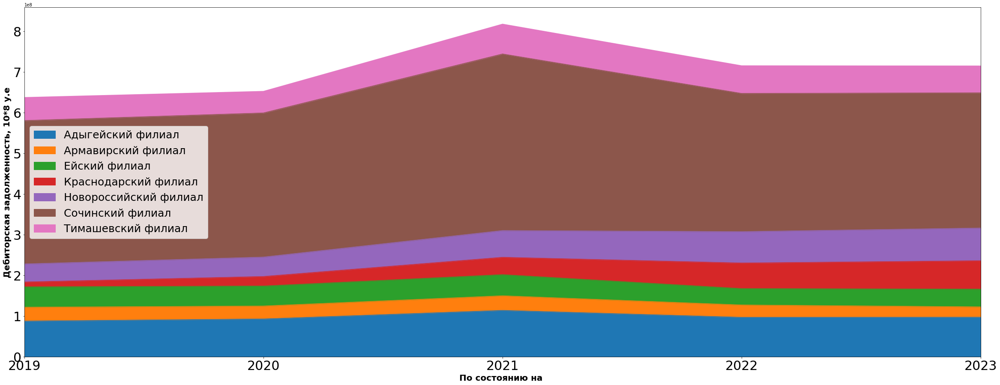

In [13]:
# ДЗ по филиалам.
df_dz_2.pivot_table(index = 'ДЗ по состоянию на', columns = 'Филиал', values = 'Дебиторская задолженность итоговая, руб.', aggfunc = 'sum').plot.area()
plt.rcParams ['figure.figsize'] = [40, 15]
plt.legend(fontsize= 25)
plt.tick_params(axis='both', which='major', labelsize=30)
#plt.plot(x, y)
plt.xlabel("По состоянию на ", fontsize=20, fontweight="bold")
plt.ylabel("Дебиторская задолженность, 10*8 у.е", fontsize=20, fontweight="bold")

Вывод: Наглядно видно, что около половины всей дебиторской задолженности ежегодно составляет Сочинский филиал, увеличиваются доли Новороссийского и Краснодарского филиалов. 

<AxesSubplot:title={'center':'ДЗ по филиалам, у.е.'}, xlabel='Филиал'>

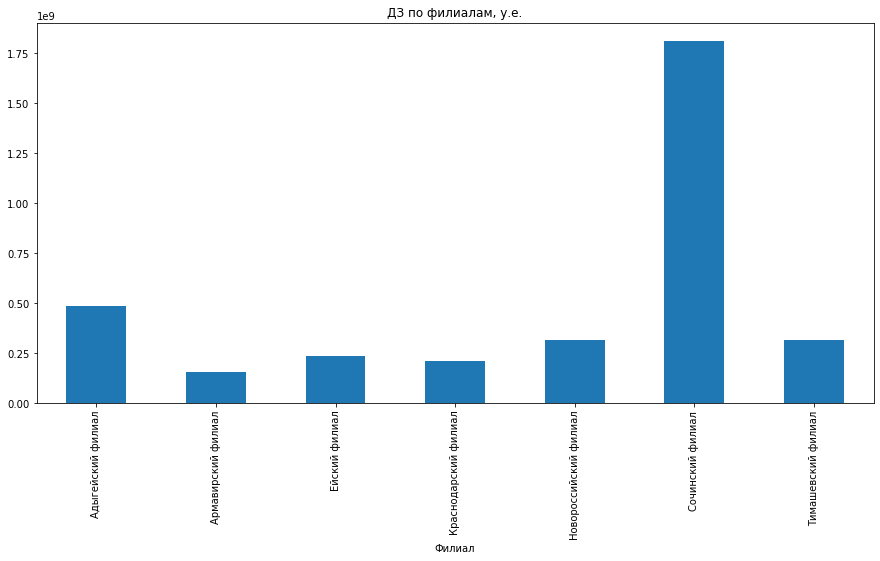

In [15]:
plt.title('ДЗ по филиалам, у.е.')
df_dz_2.groupby("Филиал")['Дебиторская задолженность итоговая, руб.'].sum().plot(kind='bar',figsize=(15,7))

In [16]:
Q3_df_dz_2 = df_dz_2['Дебиторская задолженность итоговая, руб.'].quantile(q=.75)
Q3_df_dz_2

2854.705

<AxesSubplot:>

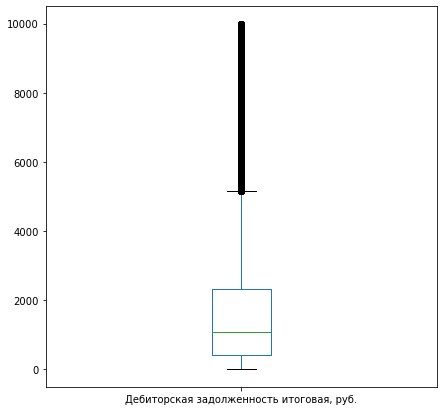

In [86]:
# так как 75 персентиль составляет менее 3 тыс. уе., наложим фильтр на ДЗ на уровне 10 тыс. уе.
df_dz_2[((df_dz_2['Дебиторская задолженность итоговая, руб.']) < 10000) &
        ((df_dz_2['Дебиторская задолженность итоговая, руб.']) > 0)].boxplot(column=['Дебиторская задолженность итоговая, руб.'],  grid= False, figsize=(7,7))

(array([0, 1]), [Text(0, 0, 'Многоквартирный'), Text(1, 0, 'Частный')])

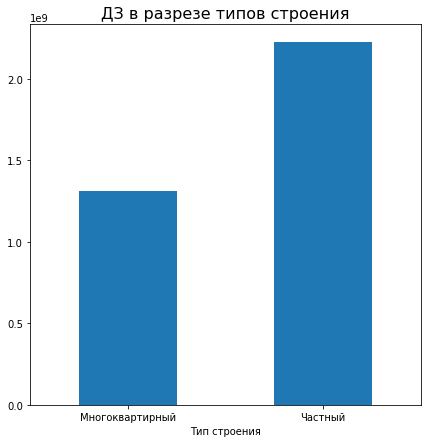

In [87]:
df_dz_2.groupby("Тип строения")['Дебиторская задолженность итоговая, руб.'].sum().plot(kind='bar',figsize=(7,7))
plt.title('ДЗ в разрезе типов строения', fontsize=16)
#plt.xlabel('Тип строения', fontsize=40)
#plt.ylabel('ДЗ, у.е.', fontsize=16)
#plt.rcParams.update({'font.size': 1})
#plt.tick_params(axis='both', which='major', labelsize=16)
plt.rc('font', size=10) #controls default text size
plt.rc('axes', titlesize=10) #fontsize of the title
plt.rc('axes', labelsize=10) #fontsize of the x and y labels
plt.rc('xtick', labelsize=10) #fontsize of the x tick labels
plt.rc('ytick', labelsize=10) #fontsize of the y tick labels
plt.rc('legend', fontsize=16)
plt.xticks(rotation=0)

Text(0.5, 1.0, 'ДЗ по датам рождения')

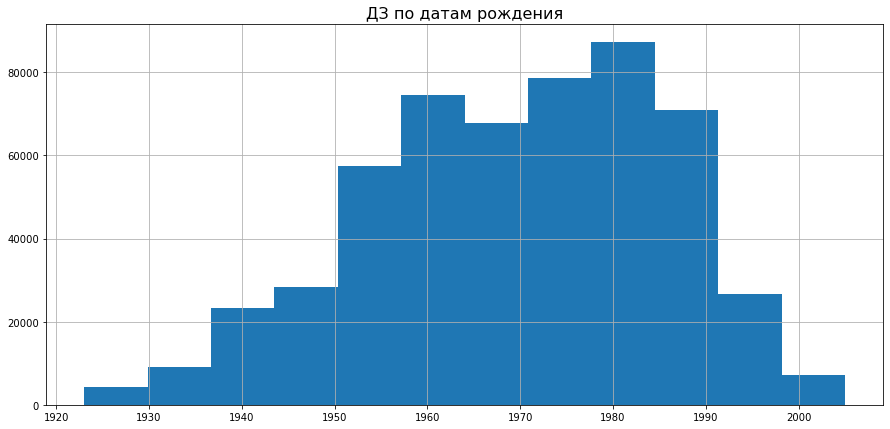

In [89]:
df_dz_2['Дата рождения'].hist(bins = 12, figsize=(15,7))
plt.title('ДЗ по датам рождения', fontsize=16)

In [18]:
df_dz_2[((df_dz_2['Дебиторская задолженность итоговая, руб.']) < 10000) &
        ((df_dz_2['Дебиторская задолженность итоговая, руб.']) > 0)].describe()

,№ лицевого счета,"Дебиторская задолженность итоговая, руб.","Текущая ДЗ, руб.","Начало образования задолженности, период","Кратность ДЗ на конец отчетного периода, ед.","Оплачено в отчетном периоде,руб.","Списано в отчетном периоде,руб.","Сумма дела отдела ограничений, руб.",Сумма дела,"Просроченная ДЗ, ИТОГО",Исковое производство,Исполнительное производство,Соглашение о рассрочке,Безнадежная,Прочая задолженность
count,7.883900e+05,7.883900e+05,788390.000000,788390.000000,788390.000000,788390.000000,788390.000000,6.362900e+05,7.883900e+05,7.883900e+05,788390.000000,788390.000000,788390.000000,788390.000000,788390.00000
mean,2.305367e+11,1.737164e+03,585.204538,9.481836,3.467370,357.492135,-15.172504,1.158681e+03,4.300010e+02,1.151959e+03,22.939691,52.500467,1.541426,24.685474,1050.29194
std,3.530162e+08,1.921970e+03,1024.657483,2.559297,4.430001,1305.731301,856.255653,7.215160e+03,3.567340e+03,1.678714e+03,348.979397,546.447146,93.760929,328.505806,1551.99299
min,2.301010e+11,3.469447e-18,-80467.810000,1.201400,0.000000,-8600.270000,-277973.380000,0.000000e+00,-5.000000e+03,1.421085e-14,0.000000,-125.860000,0.000000,-8987.590000,-9678.64000
25%,2.302033e+11,4.130000e+02,12.600000,9.201600,1.340564,0.000000,0.000000,0.000000e+00,0.000000e+00,1.273500e+02,0.000000,0.000000,0.000000,0.000000,106.23000
50%,2.304051e+11,1.089775e+03,361.200000,10.202200,2.000000,0.000000,0.000000,1.861000e+01,0.000000e+00,5.387000e+02,0.000000,0.000000,0.000000,0.000000,495.91000
75%,2.307082e+11,2.312427e+03,784.030000,11.202000,3.615158,150.000000,0.000000,1.054840e+03,0.000000e+00,1.427630e+03,0.000000,0.000000,0.000000,0.000000,1316.08000
max,2.311100e+11,9.999850e+03,9990.800000,12.202100,98.332806,419618.920000,6656.140000,2.315752e+06,1.317285e+06,8.443691e+04,29209.780000,30649.610000,9899.430000,29209.780000,84436.91000


<AxesSubplot:title={'center':'Средняя ДЗ на одного должника, у.е.'}, xlabel='Филиал'>

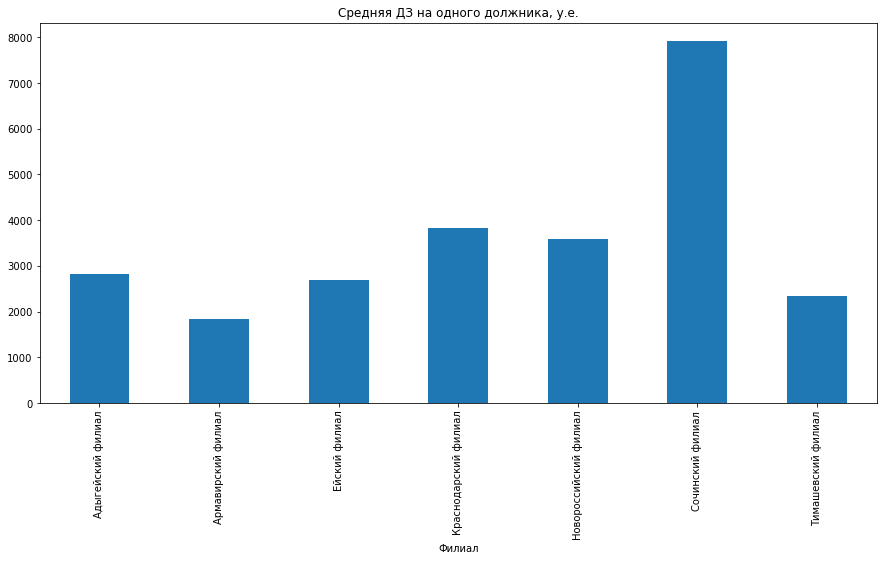

In [21]:
plt.title('Средняя ДЗ на одного должника, у.е.')
df_dz_2.groupby("Филиал")['Дебиторская задолженность итоговая, руб.'].mean().plot(kind='bar',figsize=(15,7))

Вывод: Средняя дебиторская задолженность клиента в Сочи более чем в 2 раза превышает другие филиалы.

<AxesSubplot:title={'center':'Количество должников, у.е.'}, xlabel='Филиал'>

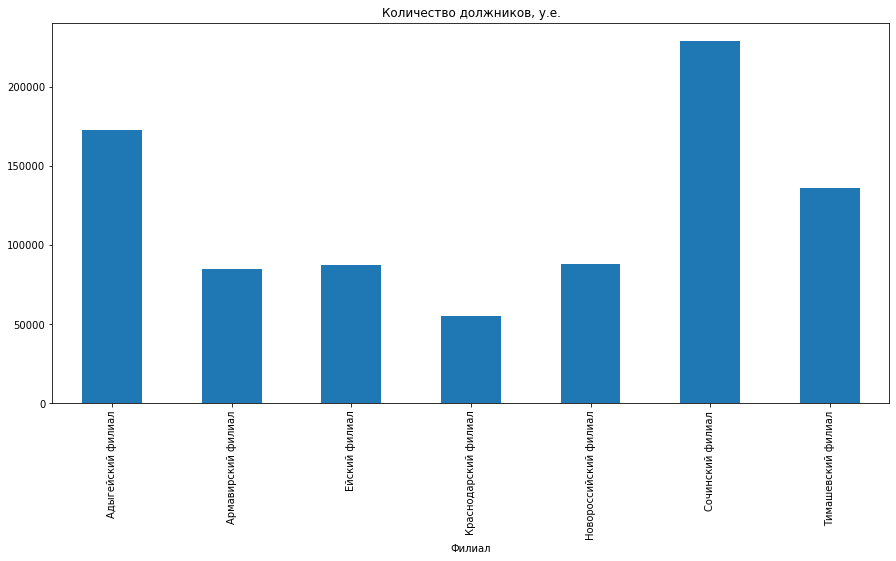

In [22]:
plt.title('Количество должников, у.е.')
df_dz_2.groupby("Филиал")['Дебиторская задолженность итоговая, руб.'].count().plot(kind='bar',figsize=(15,7))

Вывод: В лидерах по количеству должников все также Сочинский и Адыгейский филиалы

In [23]:
# Определим топ 5 участков с наибольшей ДЗ
df_dz_2.groupby('Структурное подразделение').sum().sort_values(by = 'Дебиторская задолженность итоговая, руб.', ascending = False)['Дебиторская задолженность итоговая, руб.'].head(5)

Структурное подразделение
Сочинский филиал, Центральный участок          9.755174e+08
Сочинский филиал, Адлерский участок            3.658669e+08
Сочинский филиал, Хостинский участок           2.456099e+08
Краснодарский филиал, Краснодарский участок    2.108381e+08
Адыгейский филиал, Тахтамукайский участок      1.546221e+08
Name: Дебиторская задолженность итоговая, руб., dtype: float64

Вывод: 3 из 4 участков ожидаемо оказались в Сочинском филиале, и по одному в Краснодарском и Адыгейском филиалах

<AxesSubplot:xlabel='Филиал'>

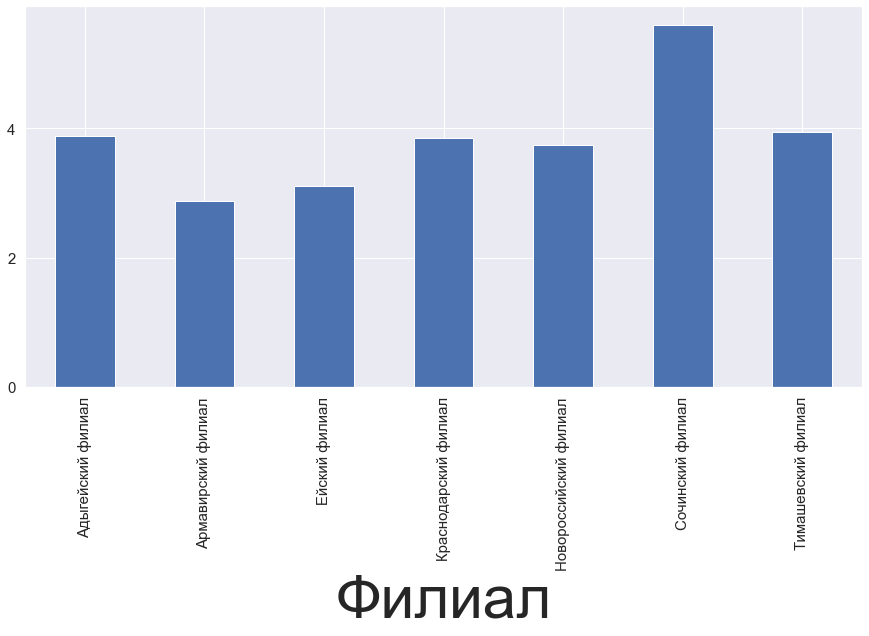

In [17]:
df_dz_2.groupby("Филиал")['Кратность ДЗ на конец отчетного периода, ед.'].mean().plot(kind='bar',figsize=(15,7), fontsize = 15)

Вывод: Средняя кратность ДЗ Сочинского филила уже не так сильно(не в разы как общая ДЗ) превышает среднюю кратность других филиалов.
Соответственно, ДЗ Сочинского филиала в большей степени связа с количеством должников, а не их средним долгом. 

<AxesSubplot:xlabel='Филиал'>

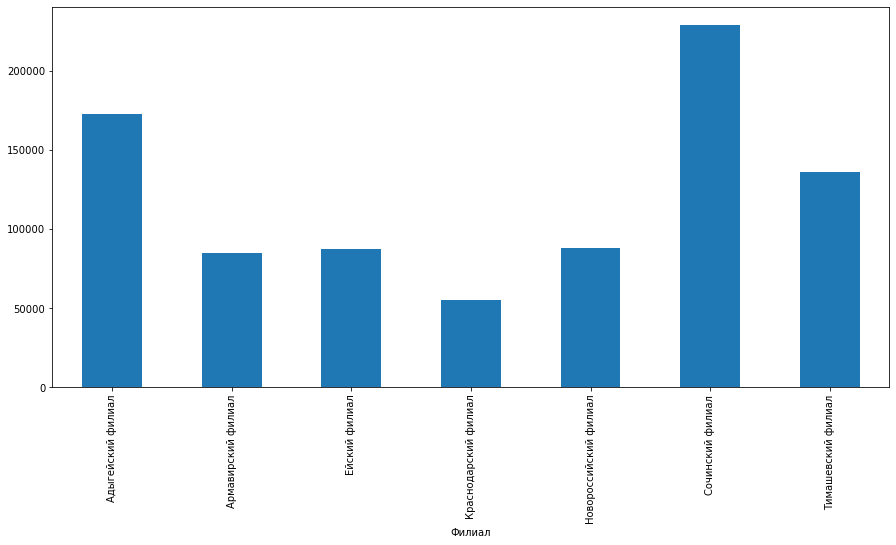

In [33]:
df_dz_2.groupby("Филиал")['Дебиторская задолженность итоговая, руб.'].count().plot(kind='bar',figsize=(15,7))

Вывод: Средняя кратность ДЗ Сочинского филила уже не так сильно(не в разы как общая ДЗ) превышает среднюю кратность других филиалов.
Соответственно, ДЗ Сочинского филиала в большей степени связа с количеством должников, а не количеством периодов просрочки. 

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


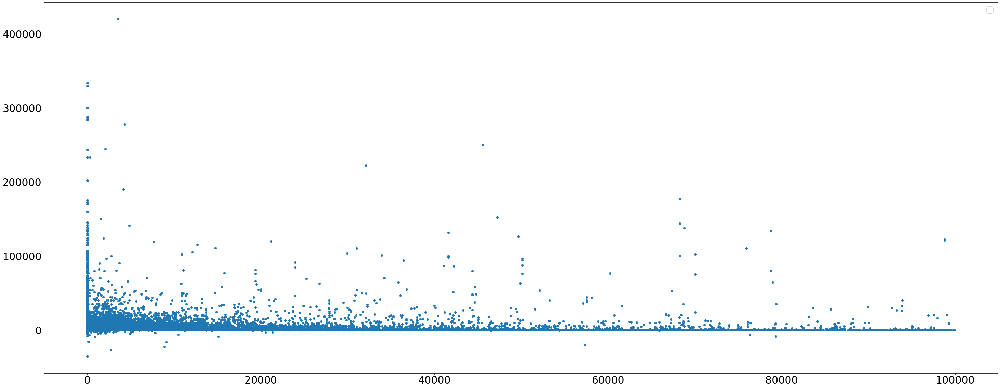

In [34]:
plt.scatter (df_dz_2['Сумма дела отдела ограничений, руб.'][df_dz_2['Сумма дела отдела ограничений, руб.'] <100000],
             df_dz_2['Оплачено в отчетном периоде,руб.'][df_dz_2['Сумма дела отдела ограничений, руб.'] <100000])
plt.rcParams ['figure.figsize'] = [50, 20]
plt.legend(fontsize= 25)
plt.tick_params(axis='both', which='major', labelsize=30)

array([[<AxesSubplot:title={'center':'Кратность ДЗ на конец отчетного периода, ед.'}>,
        <AxesSubplot:title={'center':'Начало образования задолженности, период'}>]],
      dtype=object)

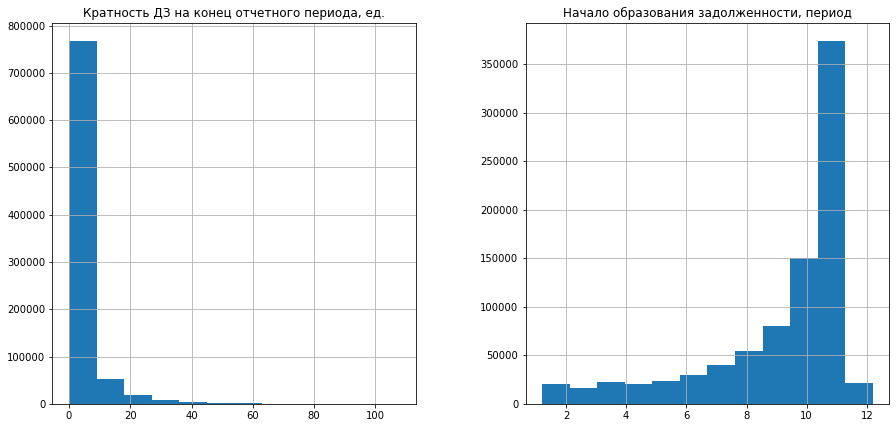

In [35]:
df_dz_2[['Кратность ДЗ на конец отчетного периода, ед.', 'Начало образования задолженности, период']].hist(bins = 12, figsize=(15,7))

Выводы:
1. Распределение частот задолженности и начала периода образования ДЗ.
Распределение ДЗ обратное, чем меньше заолженность, тем большее количество должников в данном диапазоне ДЗ
2. Распределение Начало образования задолженности прямое.
По оси x указаны месяца, задолженности. Прослеживается явная тенденция, что копить долги чаще всего начинают со второго полугодия, а именно с сентября каждого года.Такая зависимость возникает предположительно потому, что летом в сезон отпусков население уже потратило деньги отдых и на подготовку к учебному году. 
При этом с декабря долги население копит не часто, вероятно потому, что новый год все хотят встретить без долгов.

Анализ работы по введению ограничения режима потребления

In [36]:
#Функция по проверке наличия информации о проведенной работе по ограничению (отключению)
def func_not_null (data):
    if len(str(data)) > 3: # NaT - три символа.
        return 'Работа по ограничению производилась'
    return 'Работа по ограничению НЕ производилась'

In [38]:
df_dz_2['Ограничение'] = df_dz_2['Дата фазы отдела ограничений'].apply(func_not_null)

In [39]:
df_dz_2[['Дата фазы отдела ограничений', 'Ограничение']].head(12)

,Дата фазы отдела ограничений,Ограничение
1.0,2021-11-25,Работа по ограничению производилась
2.0,2023-02-16,Работа по ограничению производилась
3.0,2021-06-25,Работа по ограничению производилась
4.0,2021-08-20,Работа по ограничению производилась
5.0,2023-08-11,Работа по ограничению производилась
6.0,2021-11-25,Работа по ограничению производилась
7.0,2023-05-19,Работа по ограничению производилась
8.0,2023-01-25,Работа по ограничению производилась
9.0,2022-09-12,Работа по ограничению производилась
10.0,2023-02-22,Работа по ограничению производилась


In [40]:
df_dz_2[df_dz_2['Ограничение'] == 'Работа по ограничению производилась'].describe()

,№ лицевого счета,"Дебиторская задолженность итоговая, руб.","Текущая ДЗ, руб.","Начало образования задолженности, период","Кратность ДЗ на конец отчетного периода, ед.","Оплачено в отчетном периоде,руб.","Списано в отчетном периоде,руб.","Сумма дела отдела ограничений, руб.",Сумма дела,"Просроченная ДЗ, ИТОГО",Исковое производство,Исполнительное производство,Соглашение о рассрочке,Безнадежная,Прочая задолженность
count,7.059650e+05,7.059650e+05,705965.000000,705965.000000,705965.000000,705965.000000,705965.000000,6.964840e+05,7.059650e+05,7.059650e+05,7.059650e+05,7.059650e+05,705965.000000,7.059650e+05,7.059650e+05
mean,2.305203e+11,4.732853e+03,851.345079,9.259346,4.438205,494.288458,-26.518515,2.560527e+03,1.870755e+03,3.881508e+03,3.480420e+02,7.760453e+02,1.760445,1.895020e+02,2.566158e+03
std,3.570924e+08,3.052307e+04,3030.936572,2.701310,6.512355,2764.100501,1180.669436,2.790448e+04,2.104739e+04,3.007936e+04,8.888676e+03,1.606733e+04,318.275677,5.821956e+03,1.949352e+04
min,2.301010e+11,-3.920718e+04,-257708.330000,1.201400,0.000000,-200000.000000,-307568.330000,0.000000e+00,-5.000000e+03,1.421085e-14,0.000000e+00,-1.258600e+02,0.000000,-2.878302e+05,-7.588088e+04
25%,2.302023e+11,6.257900e+02,14.680000,8.202000,1.571024,0.000000,0.000000,0.000000e+00,0.000000e+00,2.359900e+02,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,1.787300e+02
50%,2.304042e+11,1.529750e+03,437.730000,10.202000,2.095229,0.000000,0.000000,3.274000e+01,0.000000e+00,8.295500e+02,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,7.225800e+02
75%,2.307081e+11,3.387610e+03,905.100000,11.202000,4.225508,10.000000,0.000000,1.233120e+03,0.000000e+00,2.271670e+03,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,1.922850e+03
max,2.311100e+11,5.386021e+06,826025.420000,12.202100,108.000000,477026.000000,6656.140000,5.386021e+06,4.202399e+06,5.386021e+06,3.454580e+06,5.386021e+06,166470.700000,2.921641e+06,4.109779e+06


In [41]:
df_dz_2[(df_dz_2['Ограничение'] == 'Работа по ограничению НЕ производилась')].describe()

,№ лицевого счета,"Дебиторская задолженность итоговая, руб.","Текущая ДЗ, руб.","Начало образования задолженности, период","Кратность ДЗ на конец отчетного периода, ед.","Оплачено в отчетном периоде,руб.","Списано в отчетном периоде,руб.","Сумма дела отдела ограничений, руб.",Сумма дела,"Просроченная ДЗ, ИТОГО",Исковое производство,Исполнительное производство,Соглашение о рассрочке,Безнадежная,Прочая задолженность
count,1.462020e+05,1.462020e+05,146202.000000,146202.000000,146202.000000,146202.000000,146202.000000,8.730000e+02,1.462020e+05,1.462020e+05,146202.000000,1.462020e+05,1.462020e+05,146202.000000,146202.000000
mean,2.305639e+11,1.342371e+03,330.189278,9.786366,2.800088,234.375931,-5.130020,1.363117e+04,6.181243e+02,1.012181e+03,85.728345,2.674043e+02,2.127765e+02,65.363500,380.908585
std,3.356992e+08,2.648890e+04,1166.046886,2.522312,4.354049,1596.623718,297.328914,1.149283e+05,2.382865e+04,2.626751e+04,3473.088360,2.188478e+04,1.254775e+04,4257.846353,5033.774490
min,2.301010e+11,-3.853051e+04,-42178.920000,1.201400,0.000000,-16853.180000,-73972.910000,0.000000e+00,-4.718750e+03,1.000000e-02,0.000000,0.000000e+00,0.000000e+00,-32345.230000,-277408.020000
25%,2.303037e+11,1.487650e+02,0.360000,9.202100,1.033514,0.000000,0.000000,0.000000e+00,0.000000e+00,2.907000e+01,0.000000,0.000000e+00,0.000000e+00,0.000000,23.542500
50%,2.305024e+11,4.658450e+02,154.140000,11.201800,1.629080,0.000000,0.000000,5.518700e+02,0.000000e+00,1.569850e+02,0.000000,0.000000e+00,0.000000e+00,0.000000,142.550000
75%,2.307075e+11,8.881300e+02,493.047500,11.202100,2.336348,275.000000,0.000000,4.854150e+03,0.000000e+00,4.312625e+02,0.000000,0.000000e+00,0.000000e+00,0.000000,405.030000
max,2.311100e+11,4.210345e+06,254398.540000,12.202100,79.000000,284700.740000,0.000000,3.293743e+06,4.210345e+06,4.210345e+06,545579.140000,4.210345e+06,3.382530e+06,879820.190000,679645.130000


<AxesSubplot:xlabel='Кратность ДЗ на конец отчетного периода, ед.', ylabel='Дебиторская задолженность итоговая, у.е.'>

D:\anaconda\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


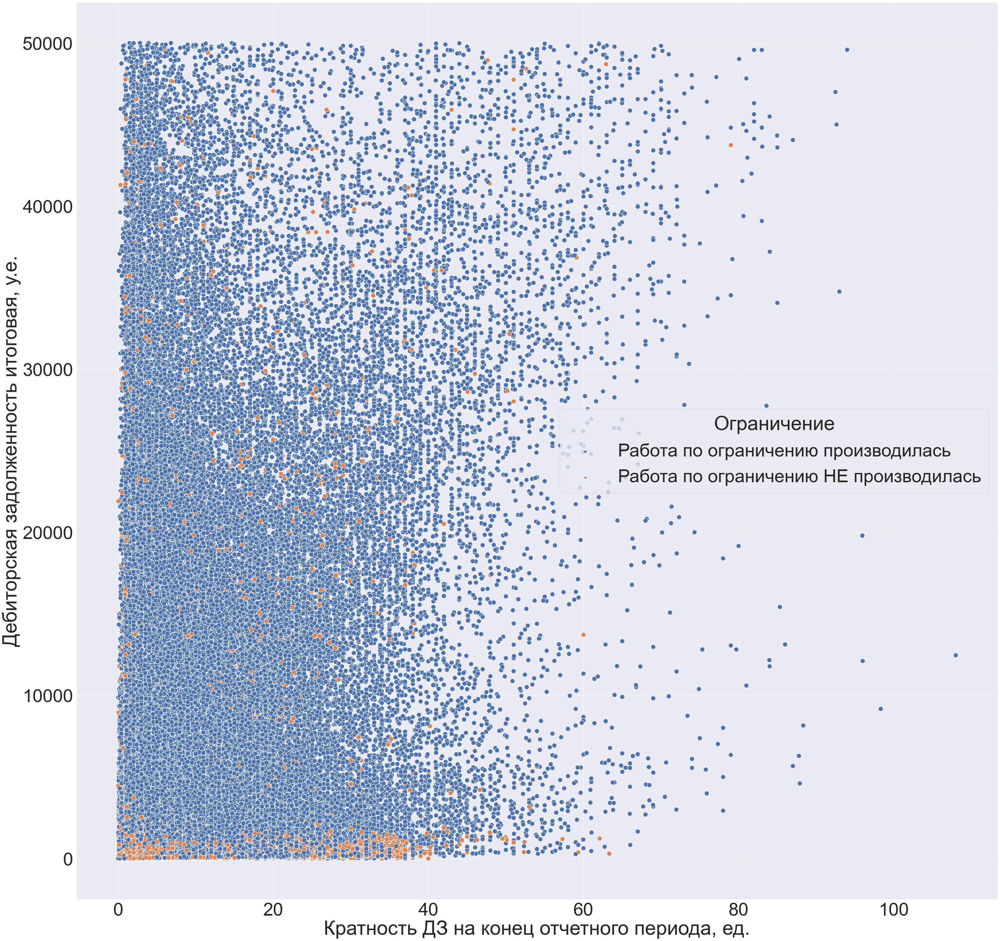

In [42]:
sns.set (font_scale= 5)
plt.rcParams ['figure.figsize'] = [50, 50]
plt.xlabel('Кратность ДЗ на конец отчетного периода, ед.')
plt.ylabel('Дебиторская задолженность итоговая, у.е.')
sns.scatterplot(x='Кратность ДЗ на конец отчетного периода, ед.', y='Дебиторская задолженность итоговая, руб.',
                hue='Ограничение', s = 200, data=df_dz_2[(df_dz_2['Дебиторская задолженность итоговая, руб.'] <50000) & (df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0)])

<AxesSubplot:>

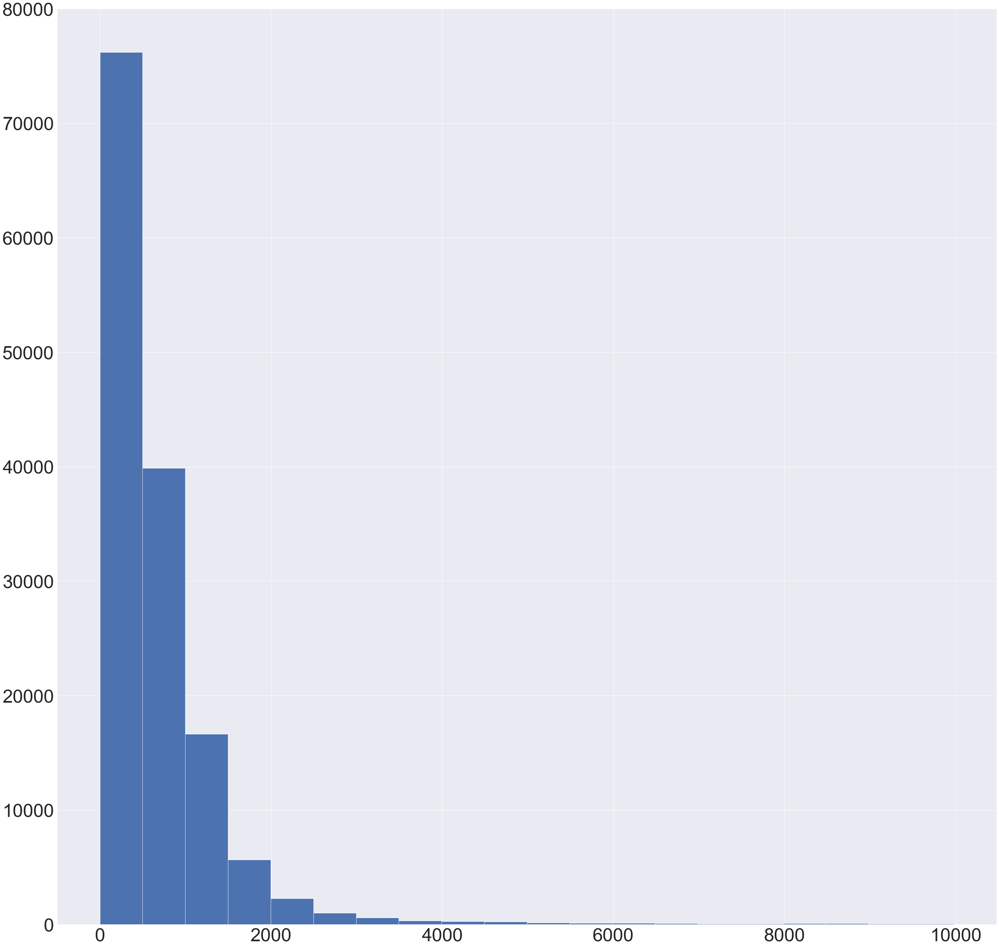

In [48]:
df_dz_2['Дебиторская задолженность итоговая, руб.'][(df_dz_2['Дебиторская задолженность итоговая, руб.'] <10000) & (df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0) &
                                               (df_dz_2['Ограничение'] == 'Работа по ограничению НЕ производилась')].hist(bins =20)

<AxesSubplot:xlabel='Кратность ДЗ на конец отчетного периода, ед.', ylabel='Дебиторская задолженность итоговая, у.е.'>

D:\anaconda\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


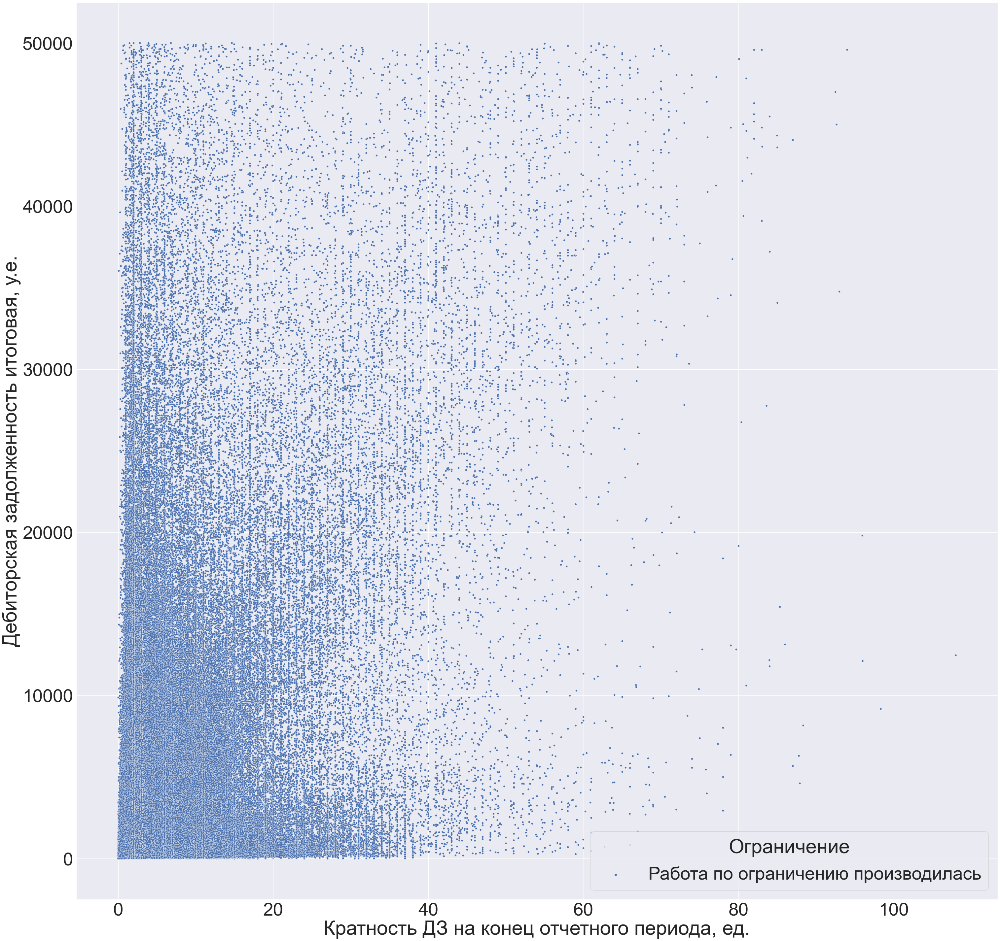

In [49]:
sns.set (font_scale= 5)
plt.rcParams ['figure.figsize'] = [50, 50]
plt.xlabel('Кратность ДЗ на конец отчетного периода, ед.')
plt.ylabel('Дебиторская задолженность итоговая, у.е.')
sns.scatterplot(x='Кратность ДЗ на конец отчетного периода, ед.', y='Дебиторская задолженность итоговая, руб.',
                hue='Ограничение', data=df_dz_2[(df_dz_2['Дебиторская задолженность итоговая, руб.'] <50000) & (df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0) &
                                               (df_dz_2['Ограничение'] == 'Работа по ограничению производилась')])

<AxesSubplot:xlabel='Кратность ДЗ на конец отчетного периода, ед.', ylabel='Дебиторская задолженность итоговая, у.е.'>

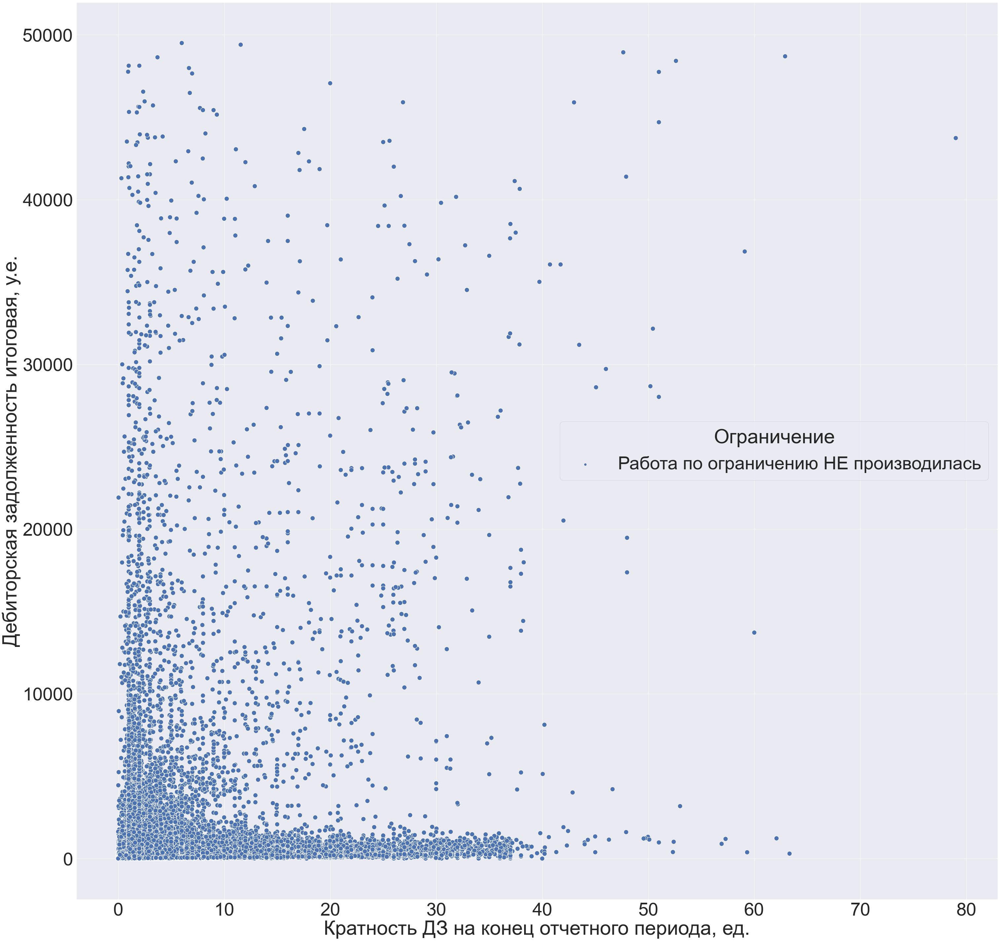

In [50]:
sns.set (font_scale= 5)
plt.rcParams ['figure.figsize'] = [50, 50]
plt.xlabel('Кратность ДЗ на конец отчетного периода, ед.')
plt.ylabel('Дебиторская задолженность итоговая, у.е.')
sns.scatterplot(x='Кратность ДЗ на конец отчетного периода, ед.', y='Дебиторская задолженность итоговая, руб.',
                hue='Ограничение', s = 200, data=df_dz_2[(df_dz_2['Дебиторская задолженность итоговая, руб.'] <50000) & (df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0) &
                                               (df_dz_2['Ограничение'] == 'Работа по ограничению НЕ производилась')])

Вывод: Наибольшая плотность оранжевых точек (работа не производилась) наблюдается при дебиторской задолженности менее 2 000 у.е. При больших значениях ДЗ, не выполненные отключения встречаются равномерно.

In [54]:
df_dz_2_plot4 = df_dz_2[df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0].pivot_table(index = 'Филиал', columns = 'Ограничение', values = 'Дебиторская задолженность итоговая, руб.', aggfunc = 'sum').reset_index()
df_dz_2_plot4['Доля охвата ДЗ работой по ограничению'] = df_dz_2_plot4['Работа по ограничению производилась']*100/(df_dz_2_plot3['Работа по ограничению НЕ производилась'] + df_dz_2_plot4['Работа по ограничению производилась'])
df_dz_2_plot4

Ограничение,Филиал,Работа по ограничению НЕ производилась,Работа по ограничению производилась,Доля охвата ДЗ работой по ограничению
0,Адыгейский филиал,26067967.89,4.615419e+08,94.653929
1,Армавирский филиал,10937695.20,1.462257e+08,93.040560
2,Ейский филиал,18248166.47,2.166960e+08,92.232979
3,Краснодарский филиал,8639072.67,2.022392e+08,95.903288
4,Новороссийский филиал,18291147.88,2.972712e+08,94.203633
5,Сочинский филиал,90521851.75,1.724054e+09,95.011404
6,Тимашевский филиал,23820399.41,2.942675e+08,92.511377


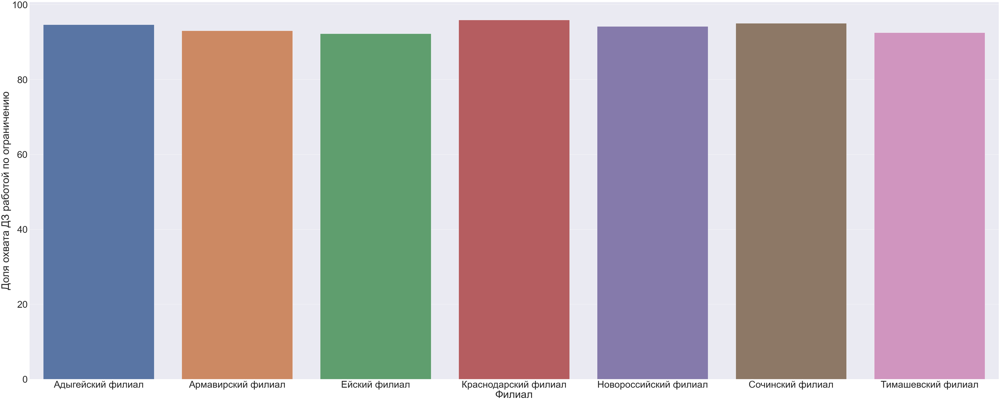

In [57]:
sns.barplot (x="Филиал", y="Доля охвата ДЗ работой по ограничению",   data=df_dz_2_plot4) 
plt.rcParams ['figure.figsize'] = [100, 40]

<AxesSubplot:xlabel='Кратность ДЗ на конец отчетного периода, ед.', ylabel='Дебиторская задолженность итоговая, у.е.'>

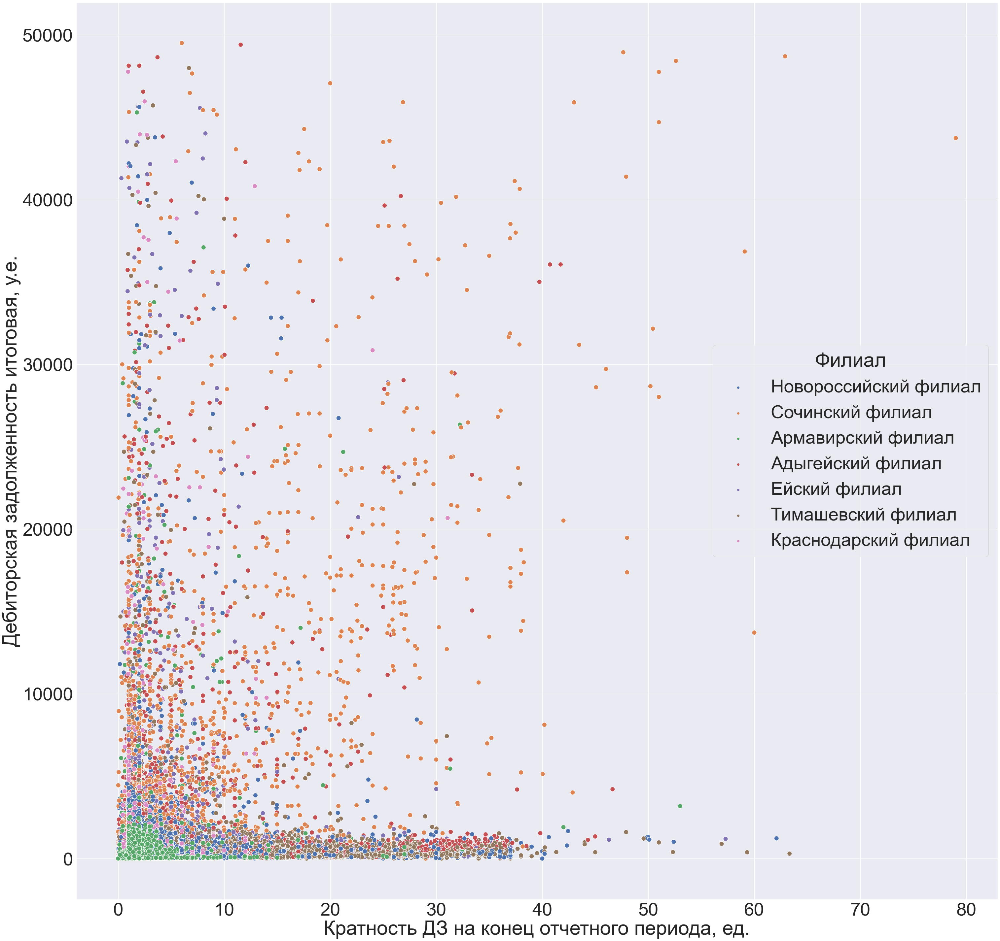

In [58]:
sns.set (font_scale= 5)
plt.rcParams ['figure.figsize'] = [50, 50]
plt.xlabel('Кратность ДЗ на конец отчетного периода, ед.')
plt.ylabel('Дебиторская задолженность итоговая, у.е.')
sns.scatterplot(x='Кратность ДЗ на конец отчетного периода, ед.', y='Дебиторская задолженность итоговая, руб.',
                hue='Филиал', s = 200, data=df_dz_2[(df_dz_2['Дебиторская задолженность итоговая, руб.'] <50000) & (df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0) &
                                               (df_dz_2['Ограничение'] == 'Работа по ограничению НЕ производилась')])

<AxesSubplot:xlabel='Кратность ДЗ на конец отчетного периода, ед.', ylabel='Дебиторская задолженность итоговая, у.е.'>

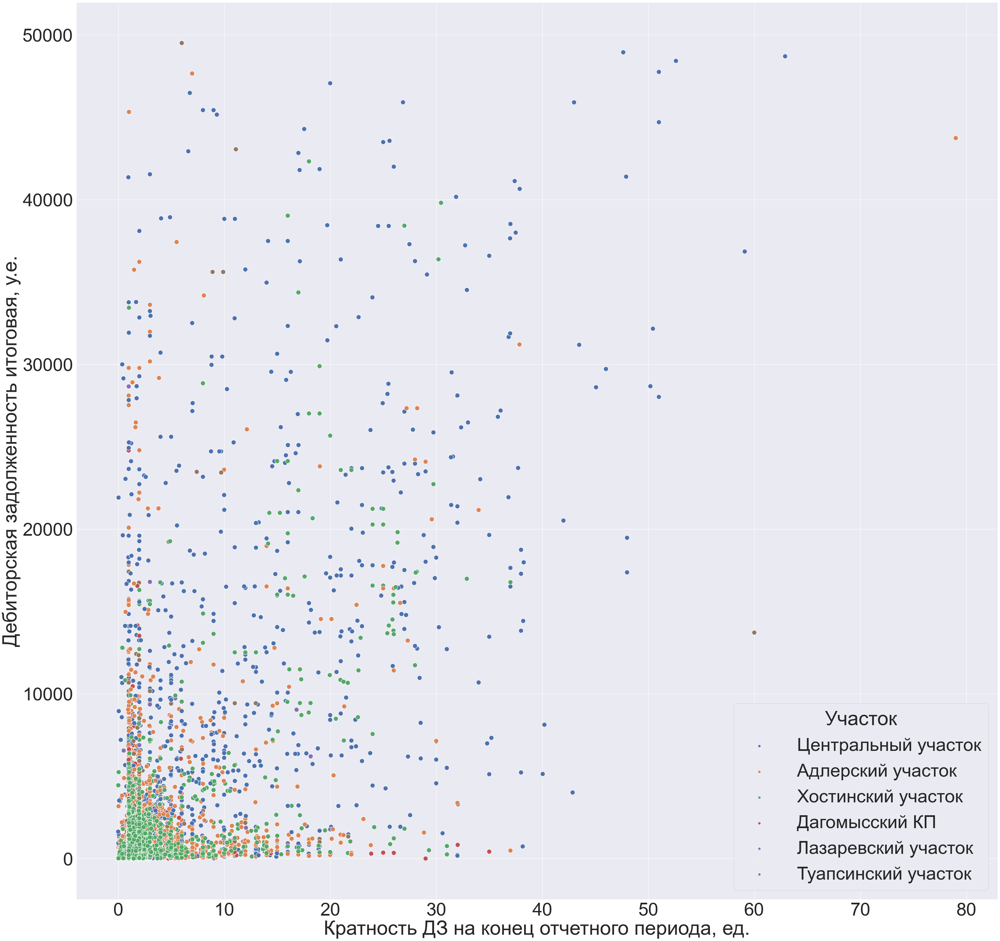

In [92]:
sns.set (font_scale= 5)
plt.rcParams ['figure.figsize'] = [50, 50]
plt.xlabel('Кратность ДЗ на конец отчетного периода, ед.')
plt.ylabel('Дебиторская задолженность итоговая, у.е.')
sns.scatterplot(x='Кратность ДЗ на конец отчетного периода, ед.', y='Дебиторская задолженность итоговая, руб.',
                hue='Участок', s = 200, data=df_dz_2[(df_dz_2['Дебиторская задолженность итоговая, руб.'] <50000) & (df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0) &
                                               (df_dz_2['Ограничение'] == 'Работа по ограничению НЕ производилась') &
                                                     (df_dz_2['Филиал'] == 'Сочинский филиал')])

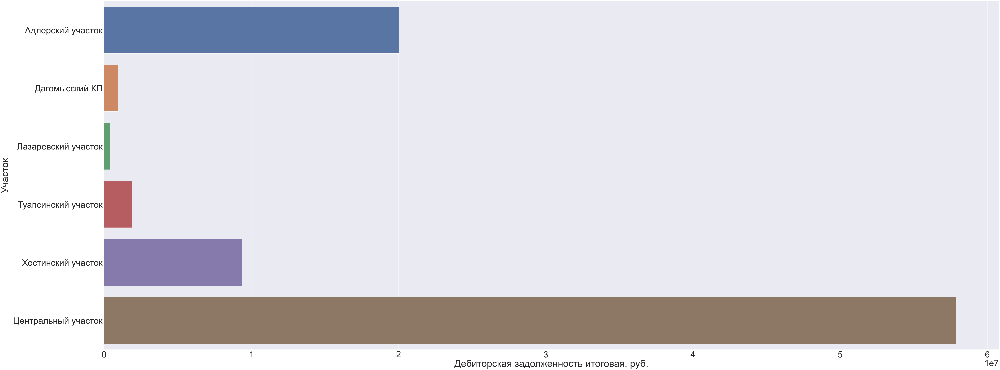

In [58]:
sns.barplot (y='Участок', x ='Дебиторская задолженность итоговая, руб.',   data=df_dz_2[(df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0) &
                                               (df_dz_2['Ограничение'] == 'Работа по ограничению НЕ производилась') &
                                                     (df_dz_2['Филиал'] == 'Сочинский филиал')].groupby("Участок")['Дебиторская задолженность итоговая, руб.'].sum().reset_index())
plt.xticks(rotation=0)
plt.rcParams ['figure.figsize'] = [40, 5]

In [102]:
df_dz_2[(df_dz_2['Дебиторская задолженность итоговая, руб.'] <50000) & (df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0) &
                                               (df_dz_2['Ограничение'] == 'Работа по ограничению НЕ производилась') &
                                                     (df_dz_2['Филиал'] == 'Сочинский филиал')].groupby("Участок")['Дебиторская задолженность итоговая, руб.'].sum() 

Участок
 Адлерский участок      10299160.52
 Дагомысский КП           571646.57
 Лазаревский участок      419035.09
 Туапсинский участок     1185827.43
 Хостинский участок      6212095.11
 Центральный участок    21024047.96
Name: Дебиторская задолженность итоговая, руб., dtype: float64

In [6]:
# Для удобства сохраним общий, очищенный датафрейм в виде pkl файла
with open('df_dz_2.pickle', 'wb') as f:
    pickle.dump(df_dz_2, f)

Анализ судебной работы 

In [3]:
#Функция по проверке наличия информации о проведенной судебной работе
def func_not_null_2 (data):
    if len(str(data)) > 3: # NaT - три символа.
        return 'Судебная работа производилась'
    return 'Судебная работа не производилась'

In [4]:
df_dz_2['Суд'] = df_dz_2['Дата дела'].apply(func_not_null_2)

In [5]:
df_dz_2[['Дата дела', 'Суд']].head()

,Дата дела,Суд
1.0,2018-12-26,Судебная работа производилась
2.0,NaT,Судебная работа не производилась
3.0,NaT,Судебная работа не производилась
4.0,NaT,Судебная работа не производилась
5.0,NaT,Судебная работа не производилась


In [8]:
df_dz_2['Суд'].value_counts()

Судебная работа не производилась    739511
Судебная работа производилась       112656
Name: Суд, dtype: int64

<AxesSubplot:xlabel='Кратность ДЗ на конец отчетного периода, ед.', ylabel='Дебиторская задолженность итоговая, у.е.'>

D:\anaconda\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


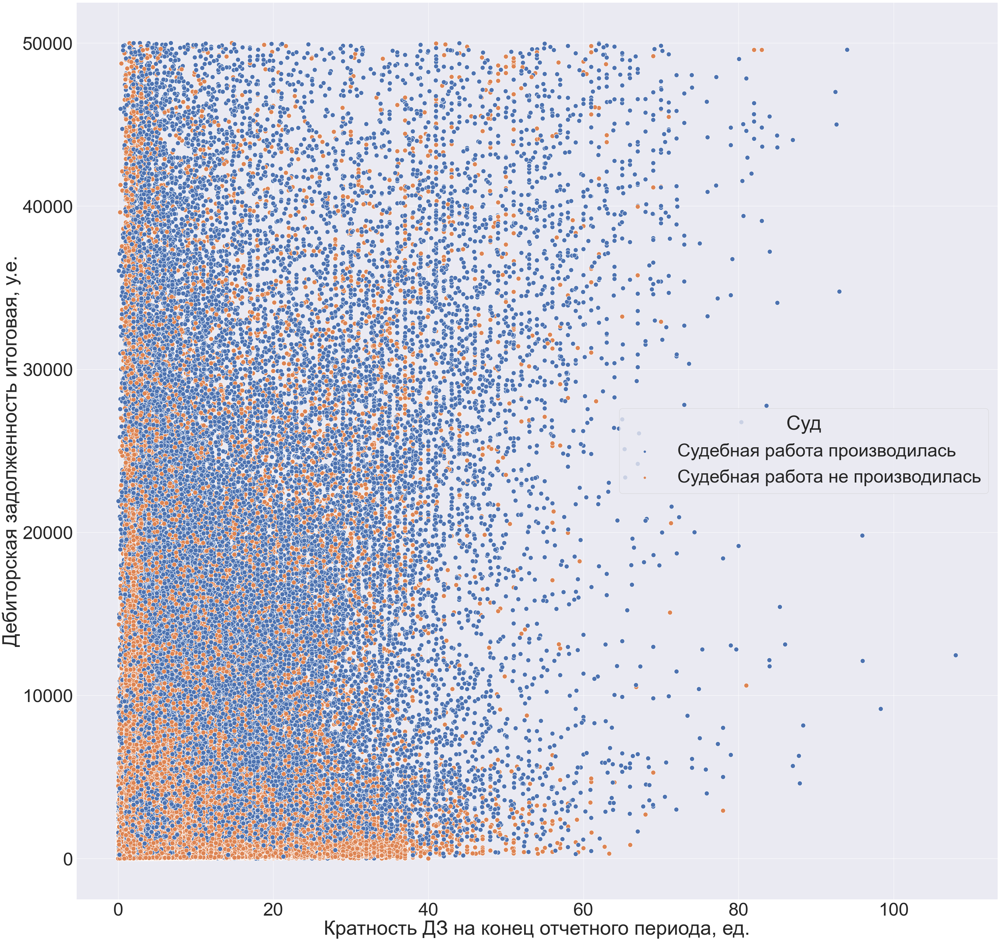

In [9]:
sns.set (font_scale= 5)
plt.rcParams ['figure.figsize'] = [50, 50]
plt.xlabel('Кратность ДЗ на конец отчетного периода, ед.')
plt.ylabel('Дебиторская задолженность итоговая, у.е.')
sns.scatterplot(x='Кратность ДЗ на конец отчетного периода, ед.', y='Дебиторская задолженность итоговая, руб.',
                hue='Суд', s = 200, data=df_dz_2[(df_dz_2['Дебиторская задолженность итоговая, руб.'] <50000) & (df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0)])

<AxesSubplot:xlabel='Кратность ДЗ на конец отчетного периода, ед.', ylabel='Дебиторская задолженность итоговая, у.е.'>

D:\anaconda\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


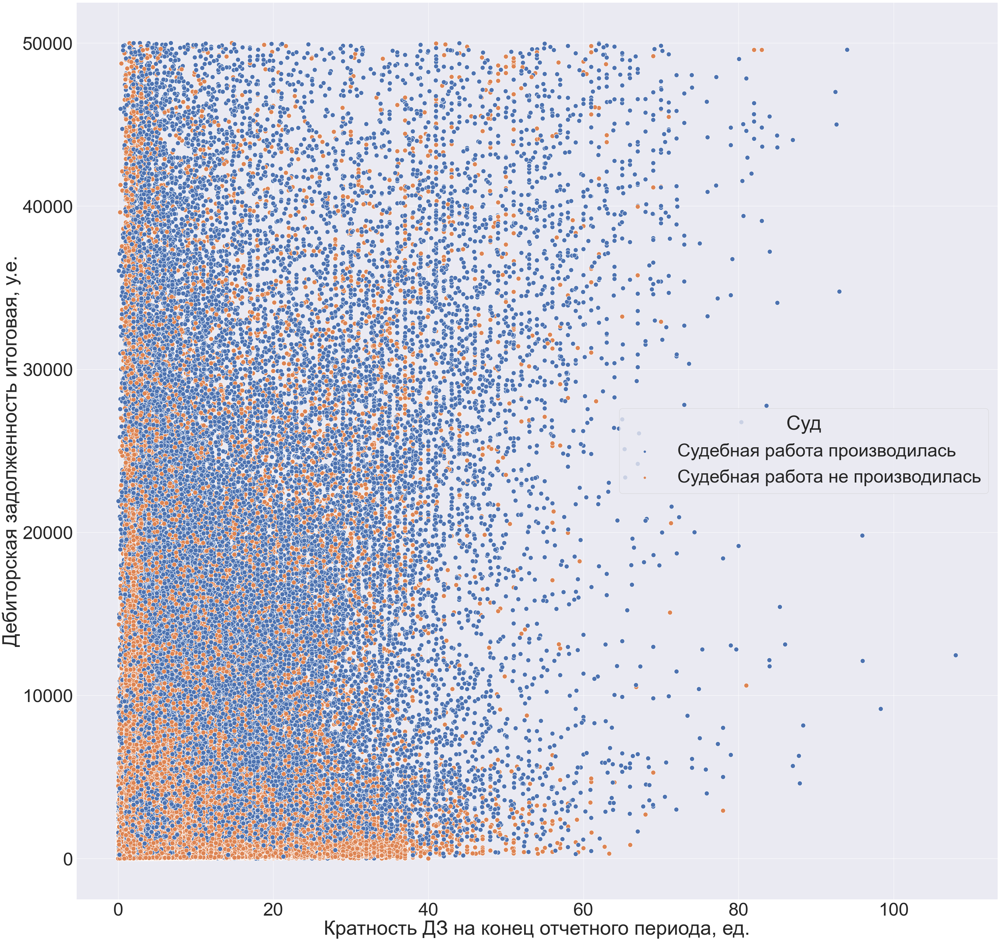

In [16]:
sns.set (font_scale= 5)
plt.rcParams ['figure.figsize'] = [50, 50]
plt.xlabel('Кратность ДЗ на конец отчетного периода, ед.')
plt.ylabel('Дебиторская задолженность итоговая, у.е.')
sns.scatterplot(x='Кратность ДЗ на конец отчетного периода, ед.', y='Дебиторская задолженность итоговая, руб.',
                hue='Суд', s = 200, data=df_dz_2[(df_dz_2['Дебиторская задолженность итоговая, руб.'] <50000) & (df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0)])

<AxesSubplot:xlabel='Кратность ДЗ на конец отчетного периода, ед.', ylabel='Дебиторская задолженность итоговая, у.е.'>

D:\anaconda\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


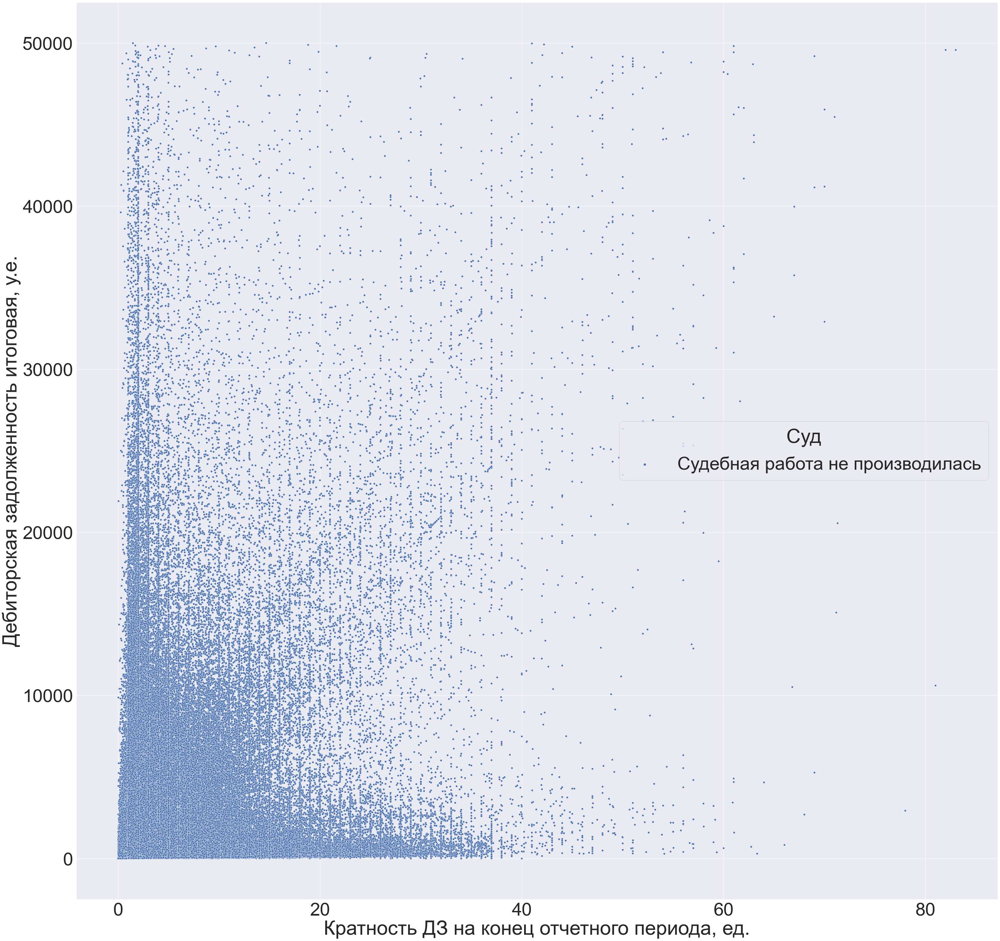

In [90]:
sns.set (font_scale= 5)
plt.rcParams ['figure.figsize'] = [50, 50]
plt.xlabel('Кратность ДЗ на конец отчетного периода, ед.')
plt.ylabel('Дебиторская задолженность итоговая, у.е.')
sns.scatterplot(x='Кратность ДЗ на конец отчетного периода, ед.', y='Дебиторская задолженность итоговая, руб.',
                hue='Суд', data=df_dz_2[(df_dz_2['Дебиторская задолженность итоговая, руб.'] <50000) & (df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0) &
                                               (df_dz_2['Суд'] == 'Судебная работа не производилась')])

<AxesSubplot:xlabel='Кратность ДЗ на конец отчетного периода, ед.', ylabel='Дебиторская задолженность итоговая, у.е.'>

D:\anaconda\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


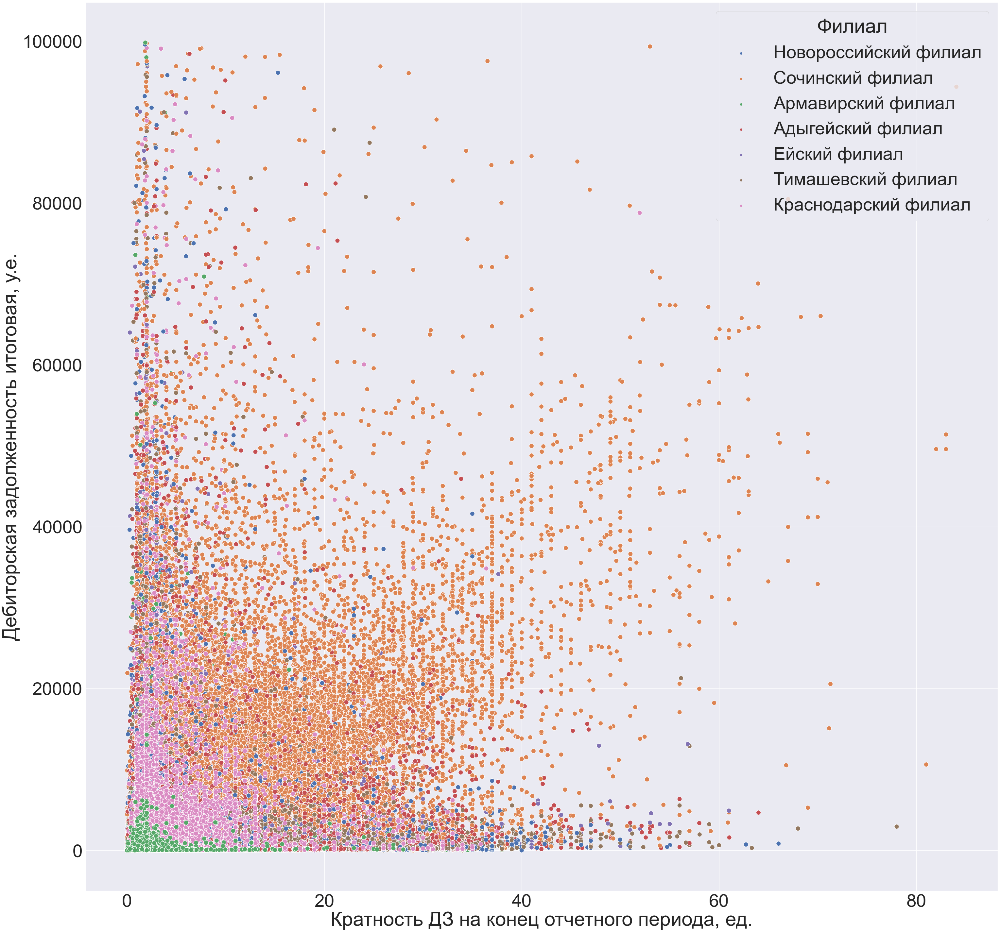

In [21]:
sns.set (font_scale= 5)
plt.rcParams ['figure.figsize'] = [50, 50]
plt.xlabel('Кратность ДЗ на конец отчетного периода, ед.')
plt.ylabel('Дебиторская задолженность итоговая, у.е.')
sns.scatterplot(x='Кратность ДЗ на конец отчетного периода, ед.', y='Дебиторская задолженность итоговая, руб.',
                hue='Филиал', s = 200, data=df_dz_2[(df_dz_2['Дебиторская задолженность итоговая, руб.'] <100000) & (df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0) &
                                               (df_dz_2['Суд'] == 'Судебная работа не производилась')])

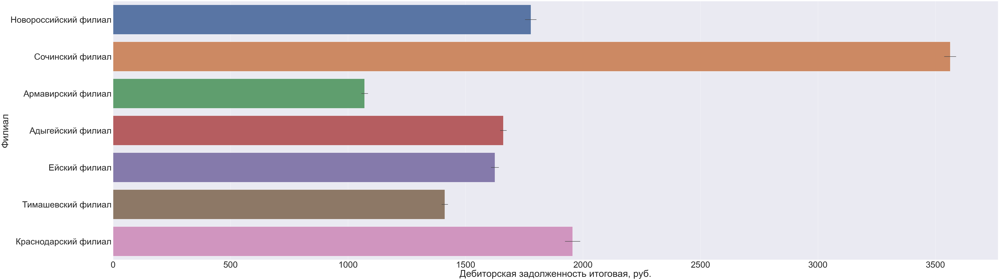

In [49]:
sns.barplot (y='Филиал', x ='Дебиторская задолженность итоговая, руб.',   data=df_dz_2[(df_dz_2['Дебиторская задолженность итоговая, руб.'] <50000) & (df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0) &
                                               (df_dz_2['Суд'] == 'Судебная работа не производилась')])
plt.xticks(rotation=0)
plt.rcParams ['figure.figsize'] = [100, 40]

Доля охвата всей ДЗ по филиалам

In [64]:
df_dz_2_plot3 = df_dz_2[df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0].pivot_table(index = 'Филиал', columns = 'Суд', values = 'Дебиторская задолженность итоговая, руб.', aggfunc = 'sum').reset_index()
df_dz_2_plot3['Доля охвата ДЗ исковой работой'] = df_dz_2_plot3['Судебная работа производилась']*100/(df_dz_2_plot3['Судебная работа не производилась'] + df_dz_2_plot3['Судебная работа производилась'])
df_dz_2_plot3

Суд,Филиал,Судебная работа не производилась,Судебная работа производилась,Доля охвата ДЗ исковой работой
0,Адыгейский филиал,2.594536e+08,2.281563e+08,46.790745
1,Армавирский филиал,7.404297e+07,8.312047e+07,52.887916
2,Ейский филиал,1.299514e+08,1.049928e+08,44.688388
3,Краснодарский филиал,1.051701e+08,1.057081e+08,50.127551
4,Новороссийский филиал,1.405744e+08,1.749879e+08,55.452712
5,Сочинский филиал,7.961843e+08,1.018391e+09,56.122842
6,Тимашевский филиал,1.842755e+08,1.338124e+08,42.067741


Вывод: Наименьшая доля охвата судебной работой ДЗ наблюдается по Тимашевскому и Ейскому филиалам. При этом наибольший охват у Сочинского филиала

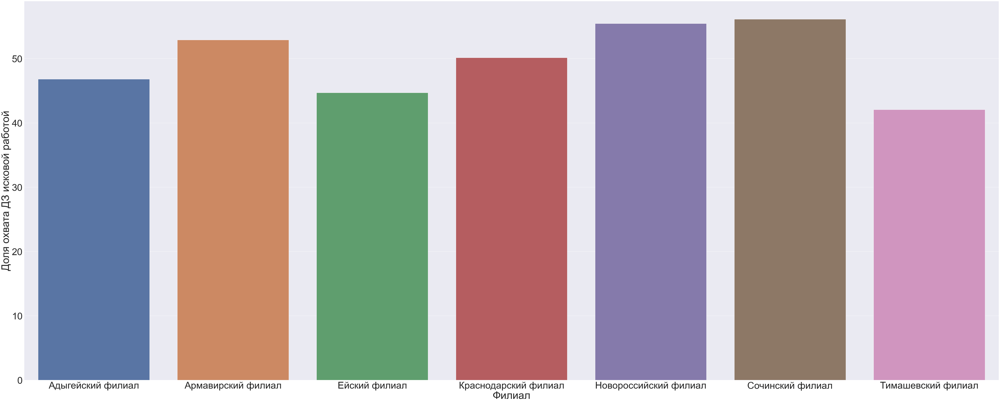

In [56]:
sns.barplot (x="Филиал", y="Доля охвата ДЗ исковой работой",   data=df_dz_2_plot3) 
plt.rcParams ['figure.figsize'] = [100, 40]

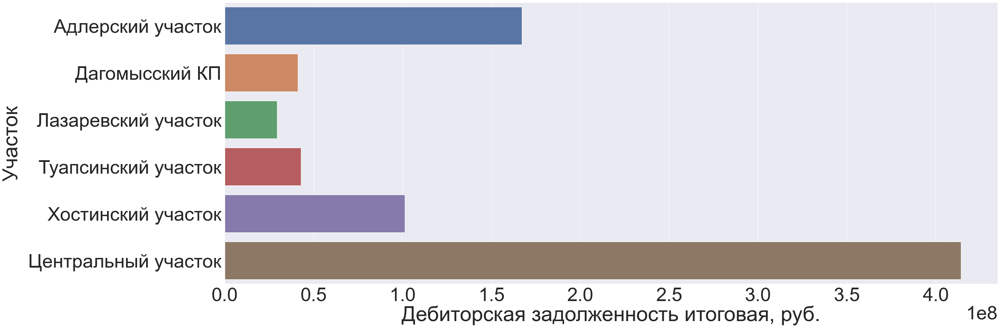

In [61]:
sns.barplot (y='Участок', x ='Дебиторская задолженность итоговая, руб.',   data=df_dz_2[(df_dz_2['Дебиторская задолженность итоговая, руб.'] > 0) &
                                               (df_dz_2['Суд'] == 'Судебная работа не производилась') &
                                                     (df_dz_2['Филиал'] == 'Сочинский филиал')].groupby("Участок")['Дебиторская задолженность итоговая, руб.'].sum().reset_index())
plt.xticks(rotation=0)
plt.rcParams ['figure.figsize'] = [40, 25]

Доля охвата всей ДЗ > 10 000 у.е. по филиалам

In [70]:
df_dz_2_plot5 = df_dz_2[df_dz_2['Дебиторская задолженность итоговая, руб.'] > 10000].pivot_table(index = 'Филиал', columns = 'Суд', values = 'Дебиторская задолженность итоговая, руб.', aggfunc = 'sum').reset_index()
df_dz_2_plot5['Доля охвата ДЗ исковой работой'] = df_dz_2_plot5['Судебная работа производилась']*100/(df_dz_2_plot5['Судебная работа не производилась'] + df_dz_2_plot5['Судебная работа производилась'])
df_dz_2_plot5

Суд,Филиал,Судебная работа не производилась,Судебная работа производилась,Доля охвата ДЗ исковой работой
0,Адыгейский филиал,5.126451e+07,1.699374e+08,76.824559
1,Армавирский филиал,7.685661e+06,4.794178e+07,86.183687
2,Ейский филиал,1.777113e+07,8.319843e+07,82.399520
3,Краснодарский филиал,4.044257e+07,9.002878e+07,69.002721
4,Новороссийский филиал,4.175631e+07,1.409300e+08,77.143163
5,Сочинский филиал,3.824834e+08,9.605705e+08,71.521366
6,Тимашевский филиал,3.101470e+07,1.041541e+08,77.054849


Text(0.5, 1.0, 'Доля охвата ДЗ > 100 тыс. у.е. исковой работой по филиалам')

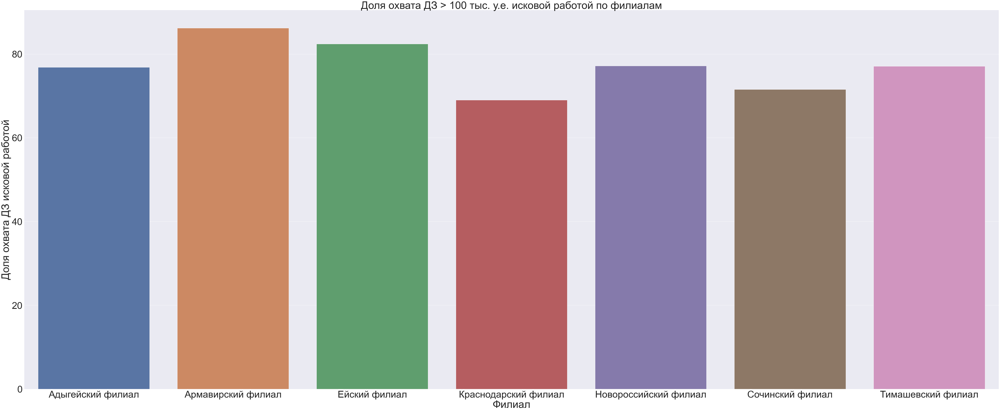

In [72]:
sns.barplot (x="Филиал", y="Доля охвата ДЗ исковой работой",   data=df_dz_2_plot5) 
plt.rcParams ['figure.figsize'] = [100, 40]
plt.title('Доля охвата ДЗ > 100 тыс. у.е. исковой работой по филиалам')

#### Поиск взаимосвязей

In [43]:
df_vol_1.groupby("LSCHET")['OB_POTR'].mean()

LSCHET
230101000001    136.40
230101000002      0.00
230101000003      8.00
230101000005    133.25
230101000019      6.40
                 ...  
231109999199     60.00
231109999423    684.80
231109999643      1.00
231109999755    216.00
231109999867    132.20
Name: OB_POTR, Length: 1125625, dtype: float64

In [47]:
df_dz_2.groupby('№ лицевого счета')['Дебиторская задолженность итоговая, руб.'].mean()

№ лицевого счета
2.301010e+11    1961.880
2.301010e+11      20.960
2.301010e+11      17.020
2.301010e+11       8.590
2.301010e+11      19.620
                  ...   
2.311100e+11    2043.670
2.311100e+11     903.315
2.311100e+11     183.610
2.311100e+11    1860.890
2.311100e+11    1829.900
Name: Дебиторская задолженность итоговая, руб., Length: 474627, dtype: float64

In [5]:
df_dz_2m = df_dz_2.groupby("№ лицевого счета")['Дебиторская задолженность итоговая, руб.'].mean().reset_index()
df_vol_1m =df_vol_1.groupby("LSCHET")['OB_POTR'].mean().reset_index()
df_dz_2m_df_vol_1m= df_dz_2m.merge(df_vol_1m, left_on = '№ лицевого счета', right_on = 'LSCHET')
df_dz_2m_df_vol_1m.head()

,№ лицевого счета,"Дебиторская задолженность итоговая, руб.",LSCHET,OB_POTR
0,2.301010e+11,1961.88,230101000001,136.4
1,2.301010e+11,20.96,230101000003,8.0
2,2.301010e+11,17.02,230101000019,6.4
3,2.301010e+11,361.20,230101001214,24.2
4,2.301010e+11,742.93,230101001438,220.0


In [6]:
df_dz_2m_df_vol_1m.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 326805 entries, 0 to 326804
Data columns (total 4 columns):
 #   Column                                    Non-Null Count   Dtype  
---  ------                                    --------------   -----  
 0   № лицевого счета                          326805 non-null  float64
 1   Дебиторская задолженность итоговая, руб.  326805 non-null  float64
 2   LSCHET                                    326805 non-null  int64  
 3   OB_POTR                                   326805 non-null  float64
dtypes: float64(3), int64(1)
memory usage: 12.5 MB


<AxesSubplot:title={'center':'Взаимосвязь электропотребления и ДЗ'}, xlabel='Среднемесячный объем электропотребления, у.е.', ylabel='Дебиторская задолженность итоговая, у.е.'>

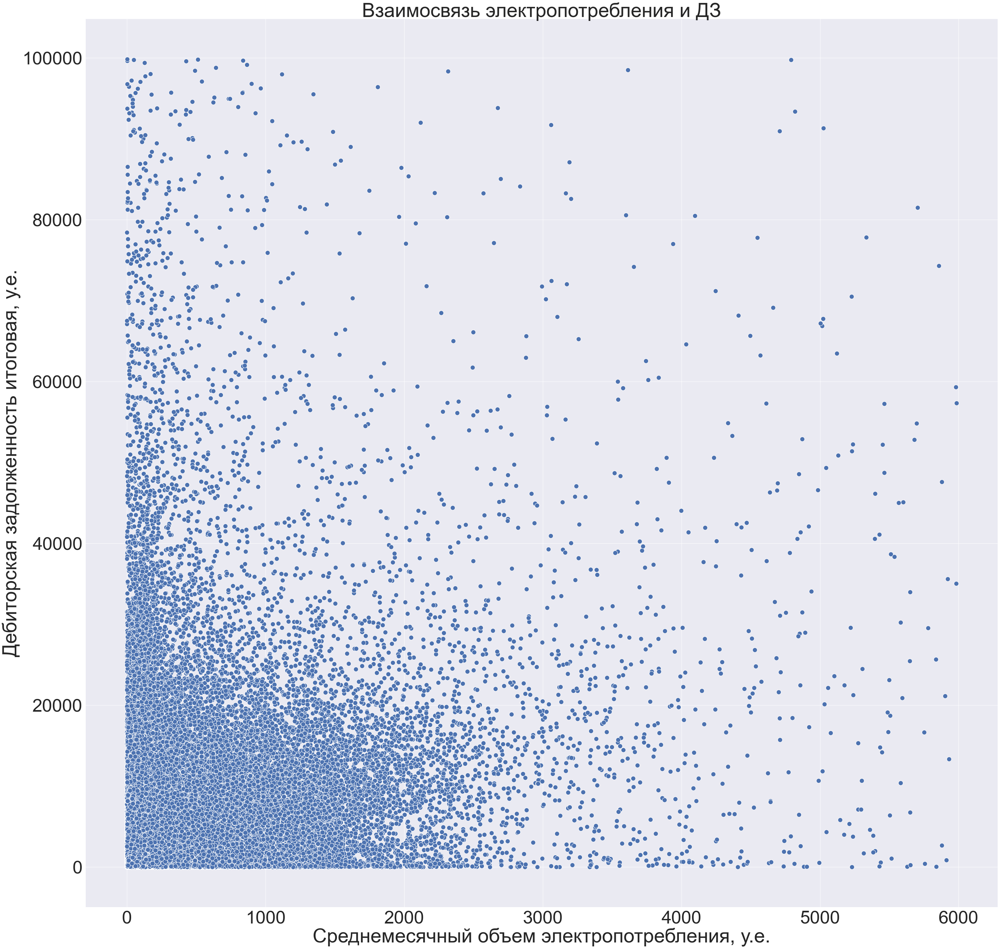

In [8]:
plt.title('Взаимосвязь электропотребления и ДЗ')
sns.set (font_scale= 5)
plt.rcParams ['figure.figsize'] = [50, 50]
plt.xlabel('Среднемесячный объем электропотребления, у.е.')
plt.ylabel('Дебиторская задолженность итоговая, у.е.')
sns.scatterplot(x='OB_POTR', y='Дебиторская задолженность итоговая, руб.',
                s = 200, data=df_dz_2m_df_vol_1m[(df_dz_2m_df_vol_1m['OB_POTR'] < 6000) &
                                                (df_dz_2m_df_vol_1m['OB_POTR'] > 0) &
                                                (df_dz_2m_df_vol_1m['Дебиторская задолженность итоговая, руб.'] < 100000) &
                                                (df_dz_2m_df_vol_1m['Дебиторская задолженность итоговая, руб.'] > 0)])

In [ ]:
df_dz_2m_df_vol_1m

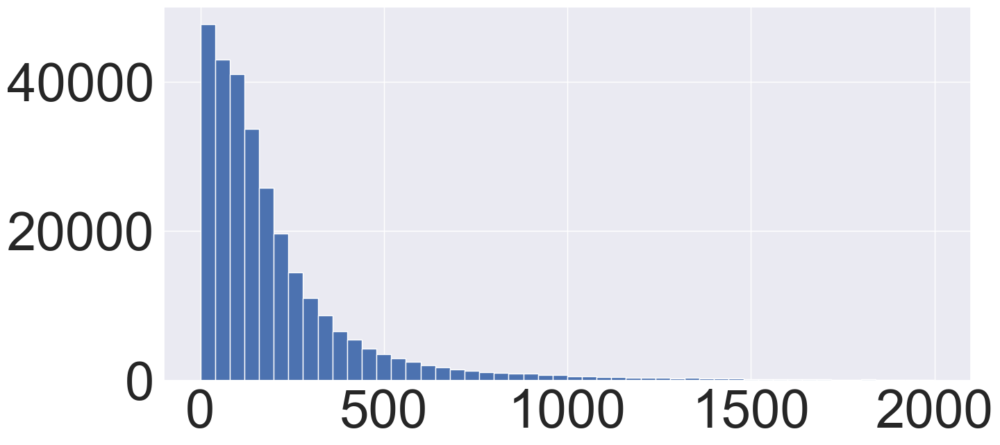

In [33]:
sns.set (font_scale= 5)
df_dz_2m_df_vol_1m['OB_POTR'][(df_dz_2m_df_vol_1m['OB_POTR'] < 2000) &
                                                              (df_dz_2m_df_vol_1m['OB_POTR'] > 0)].hist(bins = 50, figsize=(15,7))
plt.rcParams.update({'font.size': 20})

<AxesSubplot:>

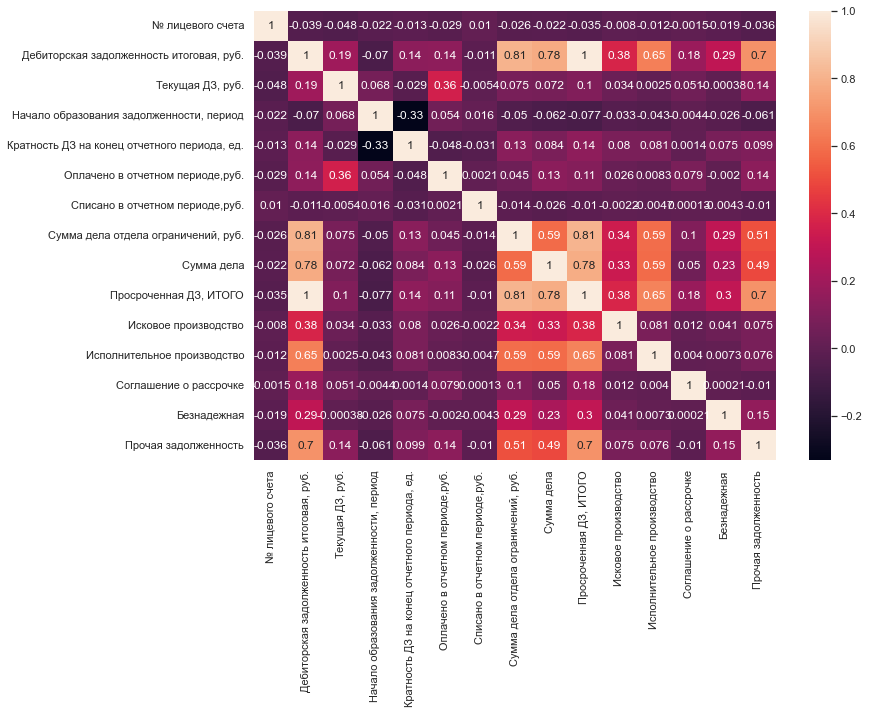

In [7]:
# удобно визуализировать при помощи тепловой карты
sns.set(rc={'figure.figsize':(11.7, 8.27)})
sns.heatmap(df_dz_2.corr(), annot=True)

<AxesSubplot:>

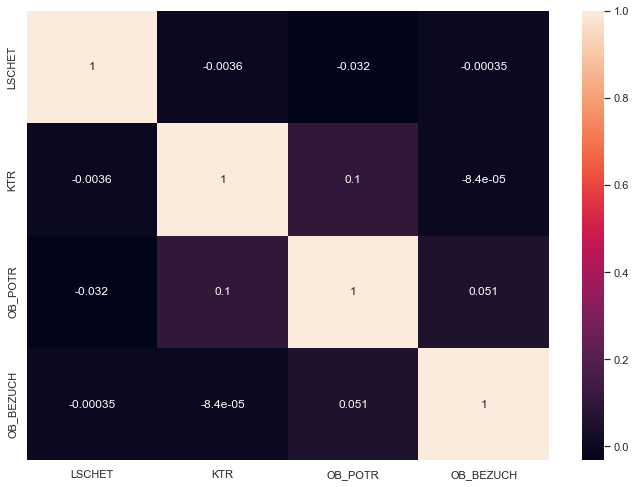

In [9]:
# удобно визуализировать при помощи тепловой карты
sns.set(rc={'figure.figsize':(11.7, 8.27)})
sns.heatmap(df_vol_1.corr(), annot=True)


##### Построение модели линейной регрессии ДЗ

In [74]:
df_dz_test= df_dz_2
df_dz_test.head()

,№ лицевого счета,Структурное подразделение,Состояние лицевого счета,Тип прибора учета,Тип строения,"Дебиторская задолженность итоговая, руб.","Текущая ДЗ, руб.","Начало образования задолженности, период","Кратность ДЗ на конец отчетного периода, ед.","Оплачено в отчетном периоде,руб.",...,Безнадежная,Прочая задолженность,Дата рождения,Место рождения,Документ удостоверяющий личность,ДЗ по состоянию на,Филиал,Участок,Ограничение,Суд
1.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,СО-ЭЭ6706 №921382,Частный,17586.78,0.00,5.2018,4.000000,0.0,...,0.0,17586.78,1976-08-05,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа производилась
2.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,NaN,Частный,2018.65,1031.99,11.2018,1.956105,1032.0,...,0.0,986.66,NaT,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
3.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ3 24 АR Е4S №64014320,Прочие,6.22,0.00,12.2017,1.000000,0.0,...,0.0,6.22,1961-08-19,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
4.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ 124 AS ОР №14000432,Прочие,436.18,0.00,6.2018,3.000000,0.0,...,0.0,436.18,1962-10-13,"РФ. г. Железногорск, Курской области",Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
5.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ3 24 АR Е4S №64013485,Прочие,5.34,0.00,12.2017,1.000000,0.0,...,0.0,5.34,1961-04-28,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась


Подготовка данных

In [75]:
df_dz_test["Тип строения"] = df_dz_test["Тип строения"].astype('category')
df_dz_test.head()

,№ лицевого счета,Структурное подразделение,Состояние лицевого счета,Тип прибора учета,Тип строения,"Дебиторская задолженность итоговая, руб.","Текущая ДЗ, руб.","Начало образования задолженности, период","Кратность ДЗ на конец отчетного периода, ед.","Оплачено в отчетном периоде,руб.",...,Безнадежная,Прочая задолженность,Дата рождения,Место рождения,Документ удостоверяющий личность,ДЗ по состоянию на,Филиал,Участок,Ограничение,Суд
1.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,СО-ЭЭ6706 №921382,Частный,17586.78,0.00,5.2018,4.000000,0.0,...,0.0,17586.78,1976-08-05,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа производилась
2.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,NaN,Частный,2018.65,1031.99,11.2018,1.956105,1032.0,...,0.0,986.66,NaT,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
3.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ3 24 АR Е4S №64014320,Прочие,6.22,0.00,12.2017,1.000000,0.0,...,0.0,6.22,1961-08-19,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
4.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ 124 AS ОР №14000432,Прочие,436.18,0.00,6.2018,3.000000,0.0,...,0.0,436.18,1962-10-13,"РФ. г. Железногорск, Курской области",Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
5.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ3 24 АR Е4S №64013485,Прочие,5.34,0.00,12.2017,1.000000,0.0,...,0.0,5.34,1961-04-28,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась


In [76]:
df_dz_test.info()

<class 'pandas.core.frame.DataFrame'>
Float64Index: 852167 entries, 1.0 to 163605.0
Data columns (total 34 columns):
 #   Column                                        Non-Null Count   Dtype         
---  ------                                        --------------   -----         
 0   № лицевого счета                              852167 non-null  float64       
 1   Структурное подразделение                     852167 non-null  object        
 2   Состояние лицевого счета                      852167 non-null  object        
 3   Тип прибора учета                             803723 non-null  object        
 4   Тип строения                                  852167 non-null  category      
 5   Дебиторская задолженность итоговая, руб.      852167 non-null  float64       
 6   Текущая ДЗ, руб.                              852167 non-null  float64       
 7   Начало образования задолженности, период      852167 non-null  float64       
 8   Кратность ДЗ на конец отчетного периода, ед.  85

In [77]:
df_dz_test["Тип строения"] = df_dz_test["Тип строения"].cat.codes
df_dz_test.head()

,№ лицевого счета,Структурное подразделение,Состояние лицевого счета,Тип прибора учета,Тип строения,"Дебиторская задолженность итоговая, руб.","Текущая ДЗ, руб.","Начало образования задолженности, период","Кратность ДЗ на конец отчетного периода, ед.","Оплачено в отчетном периоде,руб.",...,Безнадежная,Прочая задолженность,Дата рождения,Место рождения,Документ удостоверяющий личность,ДЗ по состоянию на,Филиал,Участок,Ограничение,Суд
1.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,СО-ЭЭ6706 №921382,6,17586.78,0.00,5.2018,4.000000,0.0,...,0.0,17586.78,1976-08-05,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа производилась
2.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,NaN,6,2018.65,1031.99,11.2018,1.956105,1032.0,...,0.0,986.66,NaT,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
3.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ3 24 АR Е4S №64014320,4,6.22,0.00,12.2017,1.000000,0.0,...,0.0,6.22,1961-08-19,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
4.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ 124 AS ОР №14000432,4,436.18,0.00,6.2018,3.000000,0.0,...,0.0,436.18,1962-10-13,"РФ. г. Железногорск, Курской области",Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
5.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,Нева МТ3 24 АR Е4S №64013485,4,5.34,0.00,12.2017,1.000000,0.0,...,0.0,5.34,1961-04-28,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась


In [78]:
df_dz_test["Тип прибора учета"] = df_dz_test["Тип прибора учета"].astype('category')
df_dz_test["Тип прибора учета"] = df_dz_test["Тип прибора учета"].cat.codes
df_dz_test.head()

,№ лицевого счета,Структурное подразделение,Состояние лицевого счета,Тип прибора учета,Тип строения,"Дебиторская задолженность итоговая, руб.","Текущая ДЗ, руб.","Начало образования задолженности, период","Кратность ДЗ на конец отчетного периода, ед.","Оплачено в отчетном периоде,руб.",...,Безнадежная,Прочая задолженность,Дата рождения,Место рождения,Документ удостоверяющий личность,ДЗ по состоянию на,Филиал,Участок,Ограничение,Суд
1.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,430551,6,17586.78,0.00,5.2018,4.000000,0.0,...,0.0,17586.78,1976-08-05,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа производилась
2.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,-1,6,2018.65,1031.99,11.2018,1.956105,1032.0,...,0.0,986.66,NaT,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
3.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,243579,4,6.22,0.00,12.2017,1.000000,0.0,...,0.0,6.22,1961-08-19,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
4.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,239480,4,436.18,0.00,6.2018,3.000000,0.0,...,0.0,436.18,1962-10-13,"РФ. г. Железногорск, Курской области",Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
5.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,243442,4,5.34,0.00,12.2017,1.000000,0.0,...,0.0,5.34,1961-04-28,NaN,Паспорт гражданина РФ,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась


In [79]:
df_dz_test["Дата рождения"] = df_dz_test["Дата рождения"].astype('category')
df_dz_test["Дата рождения"] = df_dz_test["Дата рождения"].cat.codes

df_dz_test["Место рождения"] = df_dz_test["Место рождения"].astype('category')
df_dz_test["Место рождения"] = df_dz_test["Место рождения"].cat.codes

df_dz_test["Документ удостоверяющий личность"] = df_dz_test["Документ удостоверяющий личность"].astype('category')
df_dz_test["Документ удостоверяющий личность"] = df_dz_test["Документ удостоверяющий личность"].cat.codes
df_dz_test.head()

,№ лицевого счета,Структурное подразделение,Состояние лицевого счета,Тип прибора учета,Тип строения,"Дебиторская задолженность итоговая, руб.","Текущая ДЗ, руб.","Начало образования задолженности, период","Кратность ДЗ на конец отчетного периода, ед.","Оплачено в отчетном периоде,руб.",...,Безнадежная,Прочая задолженность,Дата рождения,Место рождения,Документ удостоверяющий личность,ДЗ по состоянию на,Филиал,Участок,Ограничение,Суд
1.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,430551,6,17586.78,0.00,5.2018,4.000000,0.0,...,0.0,17586.78,17727,-1,9,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа производилась
2.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,-1,6,2018.65,1031.99,11.2018,1.956105,1032.0,...,0.0,986.66,-1,-1,9,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
3.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,243579,4,6.22,0.00,12.2017,1.000000,0.0,...,0.0,6.22,12262,-1,9,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
4.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,239480,4,436.18,0.00,6.2018,3.000000,0.0,...,0.0,436.18,12682,0,9,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась
5.0,2.301010e+11,"Новороссийский филиал, Абинский КП",Используется,243442,4,5.34,0.00,12.2017,1.000000,0.0,...,0.0,5.34,12149,-1,9,2019-01-01,Новороссийский филиал,Абинский КП,Работа по ограничению производилась,Судебная работа не производилась


In [80]:
df_dz_test[['Сумма дела отдела ограничений, руб.', 'Сумма дела', 'Безнадежная']] = df_dz_test[['Сумма дела отдела ограничений, руб.', 'Сумма дела', 'Безнадежная']]. fillna (0)

In [106]:
X = df_dz_test[[ 'Текущая ДЗ, руб.', 'Кратность ДЗ на конец отчетного периода, ед.', 'Дата рождения','Соглашение о рассрочке', 'Тип прибора учета', 'Сумма дела отдела ограничений, руб.' , 'Сумма дела', 'Безнадежная']]
y = df_dz_test['Дебиторская задолженность итоговая, руб.']

In [107]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

In [108]:
X_train.shape

(639125, 8)

In [109]:
X_test.shape

(213042, 8)

In [110]:
y_train.shape

(639125,)

In [111]:
model = LinearRegression()
model.fit(X_train, y_train)  # метод обучается на данных и подбирает оптимальные коэффициенты

LinearRegression()

In [112]:
model.coef_

array([ 1.29899550e+00,  1.90509832e+02,  3.52623977e-03,  7.17281389e-01,
       -1.17794072e-03,  5.70645951e-01,  6.71201264e-01,  1.89671681e-01])

In [113]:
model.intercept_

246.04768632670675

In [114]:
y_pred = model.predict(X_test)
y_pred

array([ 3048.24642317,  2711.42762374,   373.23663561, ...,
        2132.76490232, 17099.63675968,  1555.71872094])

In [115]:
X_test

,"Текущая ДЗ, руб.","Кратность ДЗ на конец отчетного периода, ед.",Дата рождения,Соглашение о рассрочке,Тип прибора учета,"Сумма дела отдела ограничений, руб.",Сумма дела,Безнадежная
15879.0,2037.00,2.000000,-1,0.0,190902,0.00,0.00,0.0
56648.0,27.07,15.000000,11373,0.0,396909,0.00,0.00,0.0
75280.0,310.80,1.179712,-1,0.0,425558,0.00,0.00,0.0
145653.0,197.03,1.099661,16853,0.0,66198,30.20,0.00,0.0
14904.0,862.71,3.834350,9687,0.0,109826,0.00,0.00,0.0
...,...,...,...,...,...,...,...,...
73108.0,442.51,2.453523,-1,0.0,155363,317.64,0.00,0.0
174639.0,1287.37,2.000000,-1,0.0,305065,0.00,0.00,0.0
45373.0,1214.84,2.535160,-1,0.0,418310,558.00,0.00,0.0
54098.0,981.93,20.666715,14612,0.0,364947,0.00,17907.02,0.0


In [116]:
y_test

15879.0      4266.15
56648.0       194.99
75280.0       413.19
145653.0      220.56
14904.0      2600.95
              ...   
73108.0      2317.64
174639.0     2021.54
45373.0      3014.38
54098.0     20852.81
114921.0     1792.88
Name: Дебиторская задолженность итоговая, руб., Length: 213042, dtype: float64

In [117]:
model.score(X_test, y_test) # метод возвращает значение коэффициента детерминации

0.7656627453944831

In [118]:
MSE_vol_dz = np.square(np.subtract(y_test,y_pred)).mean() 
RMSE_vol_dz = math.sqrt(MSE_vol_dz)
print("Root Mean Square Error:\n")
print(RMSE_vol_dz)
MSE_vol_dz
np.subtract(y_test,y_pred)

Root Mean Square Error:

13154.377061128096


15879.0     1217.903577
56648.0    -2516.437624
75280.0       39.953364
145653.0    -489.608858
14904.0      598.974440
               ...     
73108.0     1031.105510
174639.0      81.536821
45373.0      881.615098
54098.0     3753.173240
114921.0     237.161279
Name: Дебиторская задолженность итоговая, руб., Length: 213042, dtype: float64

In [119]:
# Для удобства сохраним общий, очищенный датафрейм в виде pkl файла
df_dz_test.to_pickle ("df_dz_test.pkl ")

In [3]:
# Для открытия pkl файла
with open('df_dz_test.pkl ', 'rb') as f:
     df_dz_test = pickle.load(f)

Построение модели линейной регрессии электропотребления

In [124]:
df_vol_test= df_vol_1
df_vol_test.head()

,LSCHET,PUNKT,RAYON,TIPSH,NOMSH,KTR,OB_POTR,OB_NORM,OB_BEZUCH,ODN,STATUS_SCH,SOSTOYANIE,TIPSTROY
0,230407060236,г Хадыженск,Апшеронский участок,СО-505,236141,1,20.0,0.0,0.0,0.0,Работает,Постоянный,Частный
1,230407060690,г Хадыженск,Апшеронский участок,СО-505,239294,1,100.0,0.0,0.0,0.0,Работает,Постоянный,Частный
2,230407060832,г Хадыженск,Апшеронский участок,СО-2,083430,1,20.0,0.0,0.0,0.0,Работает,Постоянный,Частный
3,230407061381,г Хадыженск,Апшеронский участок,СО-505,001541,1,0.0,0.0,0.0,0.0,Работает,Постоянный,Частный
4,230407061719,г Хадыженск,Апшеронский участок,СО-И446М,0020282,1,120.0,0.0,0.0,0.0,Работает,Постоянный,Частный


In [125]:
df_vol_test["TIPSH"] = df_vol_test["TIPSH"].astype('category')
df_vol_test["TIPSH"] = df_vol_test["TIPSH"].cat.codes
df_vol_test["RAYON"] = df_vol_test["RAYON"].astype('category')
df_vol_test["RAYON"] = df_vol_test["RAYON"].cat.codes
df_vol_test["KTR"] = df_vol_test["KTR"].astype('category')
df_vol_test["KTR"] = df_vol_test["KTR"].cat.codes
df_vol_test["STATUS_SCH"] = df_vol_test["STATUS_SCH"].astype('category')
df_vol_test["STATUS_SCH"] = df_vol_test["STATUS_SCH"].cat.codes
df_vol_test["TIPSTROY"] = df_vol_test["TIPSTROY"].astype('category')
df_vol_test["TIPSTROY"] = df_vol_test["TIPSTROY"].cat.codes
df_vol_test.head()

,LSCHET,PUNKT,RAYON,TIPSH,NOMSH,KTR,OB_POTR,OB_NORM,OB_BEZUCH,ODN,STATUS_SCH,SOSTOYANIE,TIPSTROY
0,230407060236,г Хадыженск,3,645,236141,1,20.0,0.0,0.0,0.0,12,Постоянный,8
1,230407060690,г Хадыженск,3,645,239294,1,100.0,0.0,0.0,0.0,12,Постоянный,8
2,230407060832,г Хадыженск,3,634,083430,1,20.0,0.0,0.0,0.0,12,Постоянный,8
3,230407061381,г Хадыженск,3,645,001541,1,0.0,0.0,0.0,0.0,12,Постоянный,8
4,230407061719,г Хадыженск,3,660,0020282,1,120.0,0.0,0.0,0.0,12,Постоянный,8


In [126]:
X1 = df_vol_test[['OB_NORM', 'ODN', 'KTR','TIPSTROY', 'PUNKT', 'TIPSH']][(df_vol_test['OB_POTR']>0) & (df_vol_test['OB_POTR']<1000)& (df_vol_test['OB_NORM']>0) & (df_vol_test['ODN'] ==0)]
y1 = df_vol_test['OB_POTR'][(df_vol_test['OB_POTR']>0) & (df_vol_test['OB_POTR']<1000)& (df_vol_test['OB_NORM']>0) & (df_vol_test['ODN'] ==0)]

In [127]:
X1 = df_vol_test[['OB_NORM']][(df_vol_test['OB_NORM']>0) & (df_vol_test['OB_POTR']<1000) & (df_vol_test['OB_POTR']>0)]
y1 = df_vol_test['OB_POTR'][(df_vol_test['OB_NORM']>0) & (df_vol_test['OB_POTR']<1000) & (df_vol_test['OB_POTR']>0)]

In [128]:
X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, random_state=42)

In [129]:
X1_train.shape

(82995, 1)

In [130]:
X1_test.shape

(27665, 1)

In [131]:
y1_train.shape

(82995,)

In [132]:
model1 = LinearRegression()
model1.fit(X1_train, y1_train)  # метод обучается на данных и подбирает оптимальные коэффициенты

LinearRegression()

In [133]:
model1.coef_

array([0.61700635])

In [134]:
model1.intercept_

75.7268687785957

In [135]:
y1_pred = model1.predict(X1_test)
y1_pred


array([166.42680205, 168.2778211 , 207.14922107, ..., 171.97985919,
       253.42469723, 196.66011314])

In [136]:
X1_test

,OB_NORM
254664,147.0
11385,150.0
561445,213.0
43180,80.0
967239,97.0
...,...
785227,165.0
18275,176.0
353367,156.0
227966,288.0


In [137]:
y1_test

254664    147.000
11385     150.000
561445    213.000
43180      96.342
967239     97.000
           ...   
785227    165.000
18275     176.000
353367    156.000
227966    288.000
22616     196.000
Name: OB_POTR, Length: 27665, dtype: float64

In [138]:
model1.score(X1_test, y1_test) # метод возвращает значение коэффициента детерминации

0.1554202542370643

In [139]:
MSE_vol = np.square(np.subtract(y1_test,y1_pred)).mean() 
RMSE_vol = math.sqrt(MSE_vol)
print("Root Mean Square Error:\n")
print(RMSE_vol)
MSE_vol
np.subtract(y1_test,y1_pred)

Root Mean Square Error:

84.68166226538511


254664   -19.426802
11385    -18.277821
561445     5.850779
43180    -28.745377
967239   -38.576485
            ...    
785227   -12.532916
18275     -8.319986
353367   -15.979859
227966    34.575303
22616     -0.660113
Name: OB_POTR, Length: 27665, dtype: float64

In [140]:
np.subtract(y1_test,y1_pred)

254664   -19.426802
11385    -18.277821
561445     5.850779
43180    -28.745377
967239   -38.576485
            ...    
785227   -12.532916
18275     -8.319986
353367   -15.979859
227966    34.575303
22616     -0.660113
Name: OB_POTR, Length: 27665, dtype: float64

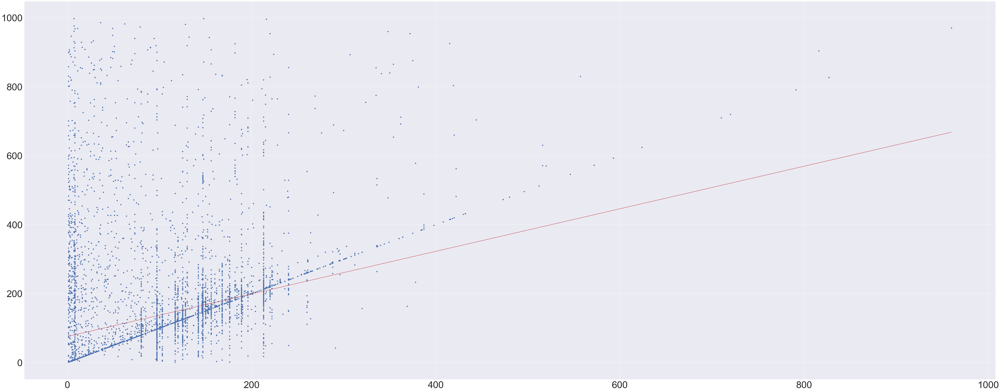

In [141]:
plt.scatter(X1_test, y1_test)
plt.plot(X1_test['OB_NORM'].tolist(), y1_pred, c='r')